In [1]:
import torchvision
import torch
import numpy as np
from sklearn.cluster import KMeans
from PIL import Image
from matplotlib import pyplot as plt
from torchvision import transforms
import torch.optim as optim


/home/ruchitjagodara/.local/lib/python3.10/site-packages/matplotlib/projections/__init__.py:63: UserWarning: Unable to import Axes3D. This may be due to multiple versions of Matplotlib being installed (e.g. as a system package and as a pip package). As a result, the 3D projection is not available.
  warnings.warn("Unable to import Axes3D. This may be due to multiple versions of "


In [2]:
if torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')

torch.Size([400, 400, 3])


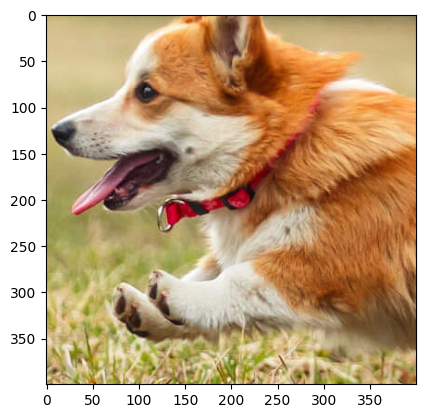

In [3]:
img = torchvision.io.read_image('dog.jpg').permute(1, 2, 0)

img = img[600:1000, 800:1200, :]

print(img.size())

img_array = np.array(img)

plt.imshow(img_array)

# For N = 30

# For 1 Colour

torch.Size([2700])


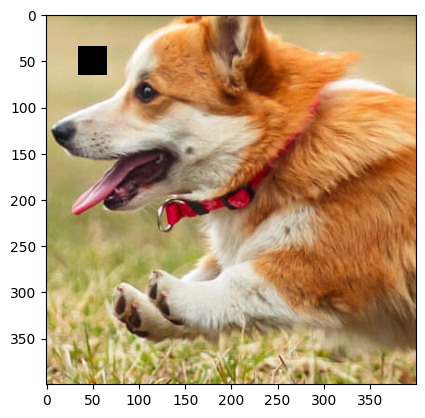

In [388]:
img_1c = img.clone().detach()
img_1c = img_1c.to(torch.float32)
img_1c[35:65, 35:65, :] = torch.nan
plt.imshow(img_1c/255)
print(img_1c[img_1c.isnan()].size())

In [389]:
img_array = img_1c

/tmp/ipykernel_6127/3352673191.py:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]
/tmp/ipykernel_6127/3352673191.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  red_values = torch.tensor(img_array[:, column_index, 0])
/tmp/ipykernel_6127/3352673191.py:9: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  green_values = torch.tensor(img_array[:, column_index, 1])
/tmp/ipykernel_6127/3352673191.py:11: UserWarning: To copy construct from a tensor, it is recommended to use

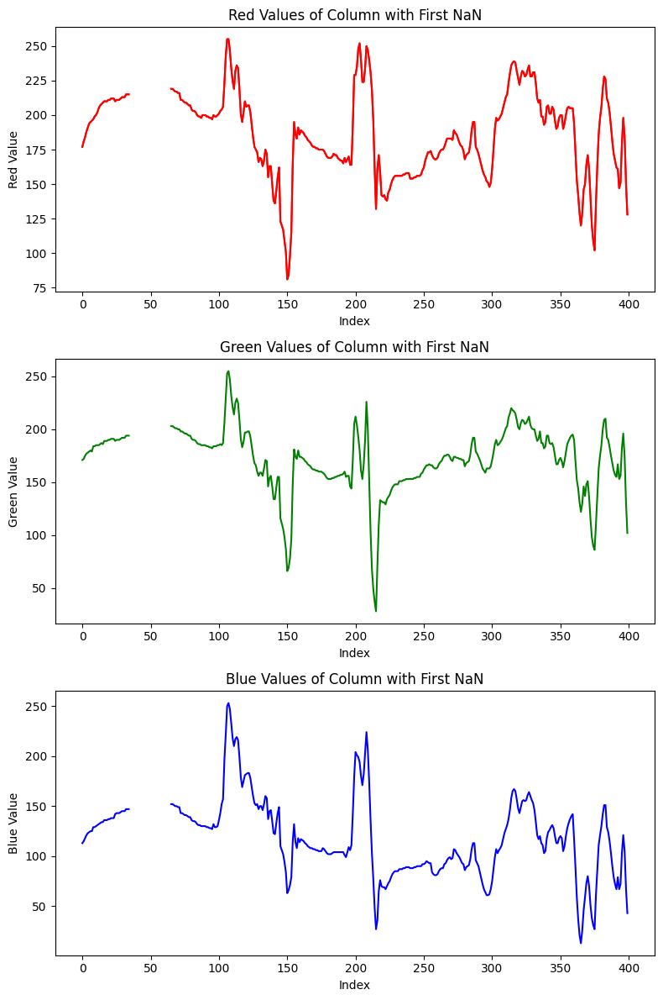

<Figure size 640x480 with 0 Axes>

In [390]:
import matplotlib.pyplot as plt

# Find the column index where the first NaN value occurs
column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]

# Get the red values of the column
red_values = torch.tensor(img_array[:, column_index, 0])
# Get the green values of the column
green_values = torch.tensor(img_array[:, column_index, 1])
# Get the blue values of the column
blue_values = torch.tensor(img_array[:, column_index, 2])

# Create subplots
fig, axs = plt.subplots(3, 1, figsize=(8, 12))

# Plot the red values
axs[0].plot(red_values, color='red')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')
# Plot the red values with missing values as black
axs[0].plot(red_values, color='red')
axs[0].scatter(torch.where(torch.isnan(red_values))[0], red_values[torch.isnan(red_values)], color='black')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')

# Plot the green values with missing values as black
axs[1].plot(green_values, color='green')
axs[1].scatter(torch.where(torch.isnan(green_values))[0], green_values[torch.isnan(green_values)], color='black')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values with missing values as black
axs[2].plot(blue_values, color='blue')
axs[2].scatter(torch.where(torch.isnan(blue_values))[0], blue_values[torch.isnan(blue_values)], color='black')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()

# Plot the green values
axs[1].plot(green_values, color='green')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values
axs[2].plot(blue_values, color='blue')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()


In [391]:
def factorize(A, k, device, lambda_reg):
    W = torch.randn(A.shape[0], k, dtype=torch.float32, device=device, requires_grad=True)
    H = torch.randn(k, A.shape[1], dtype=torch.float32, device=device, requires_grad=True)
    mask3 = ~torch.isnan(A)
    A_est = torch.matmul(W, H)
    error = torch.norm(A[mask3] - A_est[mask3])
    regularization = lambda_reg * (torch.norm(W) + torch.norm(H))
    loss = error + regularization

    optimizer = optim.SGD([W, H], lr=0.02)

    for i in range(5000):
        optimizer.zero_grad()

        A_est = torch.matmul(W, H)
        error = torch.norm(A[mask3] - A_est[mask3])
        regularization = lambda_reg * (torch.norm(W) + torch.norm(H))
        loss = error + regularization

        loss.backward()
        optimizer.step()

        error = torch.norm(A[mask3] - A_est[mask3])
        # print(error)

    return W, H



In [392]:
## for 1 colour train the model

A = img_array.clone().detach().to(torch.float32).to(device)
k = 180     # Here, k should be very very small than A.shape[0] and A.shape[1] 
lambda_reg = 0.12  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


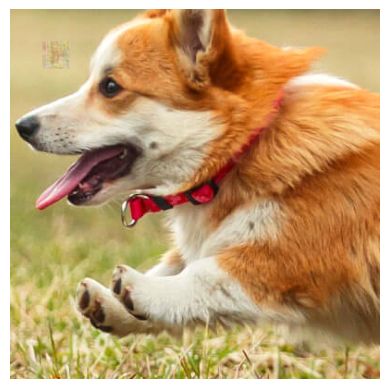

In [393]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


/tmp/ipykernel_6127/319164057.py:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]


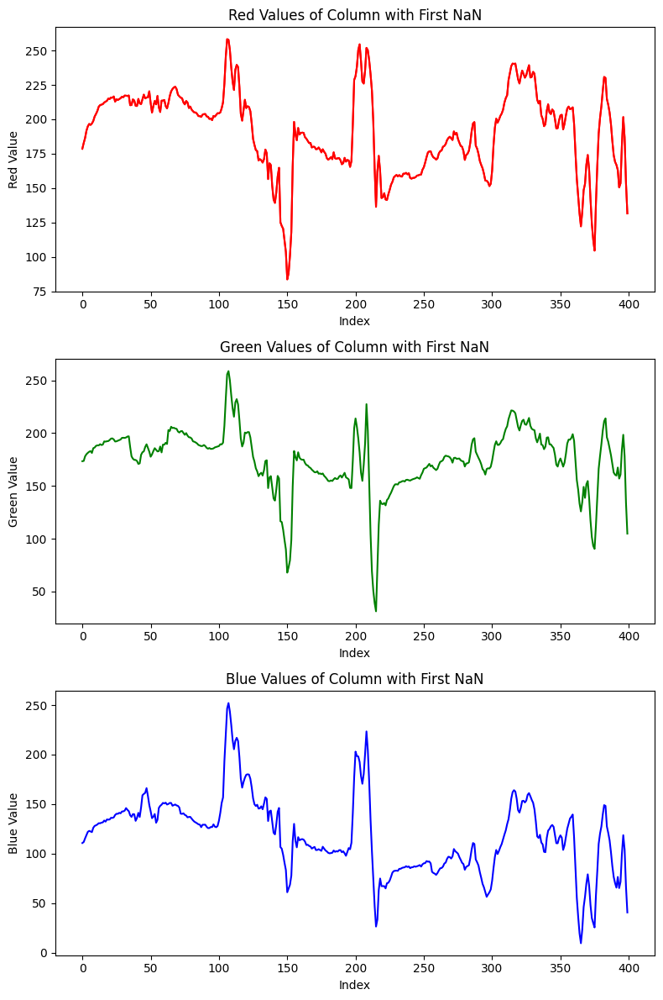

<Figure size 640x480 with 0 Axes>

In [394]:
import matplotlib.pyplot as plt

# Find the column index where the first NaN value occurs
column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]

# Get the red values of the column
red_values = (red_img[:, column_index]).cpu().detach().numpy()
# Get the green values of the column
green_values = (green_img[:, column_index]).cpu().detach().numpy()
# Get the blue values of the column
blue_values = (blue_img[:, column_index]).cpu().detach().numpy()

# Create subplots
fig, axs = plt.subplots(3, 1, figsize=(8, 12))

# Plot the red values
axs[0].plot(red_values, color='red')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')
# Plot the red values with missing values as black
axs[0].plot(red_values, color='red')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')

# Plot the green values with missing values as black
axs[1].plot(green_values, color='green')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values with missing values as black
axs[2].plot(blue_values, color='blue')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()

# Plot the green values
axs[1].plot(green_values, color='green')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values
axs[2].plot(blue_values, color='blue')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()


# Metrics:

In [395]:
import numpy as np

# Convert the predicted image (A) and the original image (img) to numpy arrays
predicted_image = final_img
original_image = img.detach().cpu().numpy()

# Calculate the squared difference between the predicted and original images
squared_diff = np.square(predicted_image - original_image)

# Calculate the mean squared difference
mean_squared_diff = np.mean(squared_diff)

# Calculate the RMSE by taking the square root of the mean squared difference
rmse = np.sqrt(mean_squared_diff)

# Print the RMSE
print("RMSE:", rmse)


RMSE: 3.0845327


In [396]:
import numpy as np

def calculate_psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

psnr = calculate_psnr(final_img, np.array(img))
print("Peak Signal-to-Noise Ratio (PSNR):", psnr)


Peak Signal-to-Noise Ratio (PSNR): 38.59339237213135


# For 2 colours

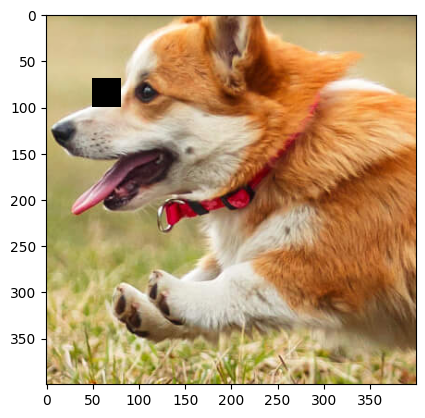

In [397]:
img_23c = img.clone().detach()
img_23c = img_23c.to(torch.float32)
img_23c[70:100, 50:80, :] = torch.nan
plt.imshow(img_23c/255)

In [398]:
img_array = img_23c

In [399]:
## for 2 colours
A = torch.tensor(img_array, dtype=torch.float32, device=device)
k = 200
lambda_reg = 0.14  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)

/tmp/ipykernel_6127/91293281.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(img_array, dtype=torch.float32, device=device)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


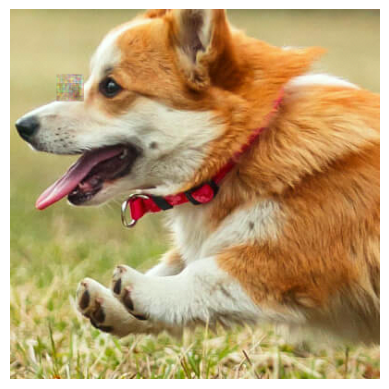

In [400]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


# Metrics:

In [401]:
import numpy as np

# Convert the predicted image (A) and the original image (img) to numpy arrays
predicted_image = final_img
original_image = img.detach().cpu().numpy()

# Calculate the squared difference between the predicted and original images
squared_diff = np.square(predicted_image - original_image)

# Calculate the mean squared difference
mean_squared_diff = np.mean(squared_diff)

# Calculate the RMSE by taking the square root of the mean squared difference
rmse = np.sqrt(mean_squared_diff)

# Print the RMSE
print("RMSE:", rmse)


RMSE: 5.0014925


In [402]:
import numpy as np

def calculate_psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

psnr = calculate_psnr(final_img, np.array(img))
print("Peak Signal-to-Noise Ratio (PSNR):", psnr)


Peak Signal-to-Noise Ratio (PSNR): 34.329824447631836


# For 5 colours

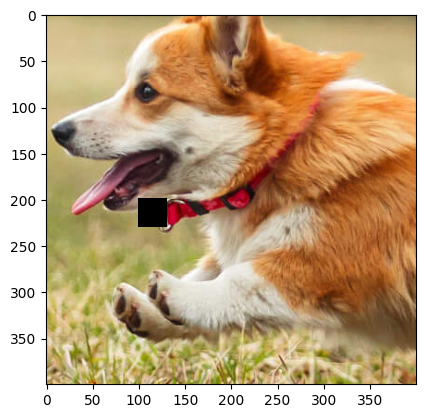

In [403]:
img_5c = img.clone().detach()
img_5c = img_5c.to(torch.float32)
img_5c[200:230, 100:130, :] = torch.nan
plt.imshow(img_5c/255)

In [404]:
img_array = img_5c

In [405]:
# for 5 colour
A = torch.tensor(img_array, dtype=torch.float32, device=device)
k = 100
lambda_reg = 0.09  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)


/tmp/ipykernel_6127/3159195331.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(img_array, dtype=torch.float32, device=device)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


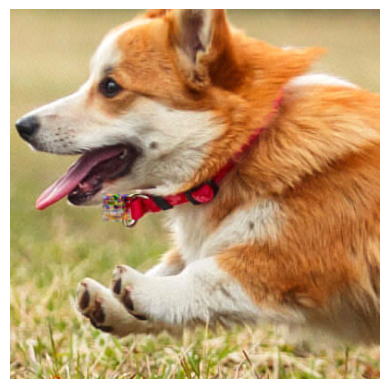

In [406]:
# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


# Metrics:

In [407]:
import numpy as np

# Convert the predicted image (A) and the original image (img) to numpy arrays
predicted_image = final_img
original_image = img.detach().cpu().numpy()

# Calculate the squared difference between the predicted and original images
squared_diff = np.square(predicted_image - original_image)

# Calculate the mean squared difference
mean_squared_diff = np.mean(squared_diff)

# Calculate the RMSE by taking the square root of the mean squared difference
rmse = np.sqrt(mean_squared_diff)

# Print the RMSE
print("RMSE:", rmse)


RMSE: 5.242036


In [408]:
import numpy as np

def calculate_psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

psnr = calculate_psnr(final_img, np.array(img))
print("Peak Signal-to-Noise Ratio (PSNR):", psnr)


Peak Signal-to-Noise Ratio (PSNR): 34.555299282073975


# N = 20

# For 1 Colour

torch.Size([1200])


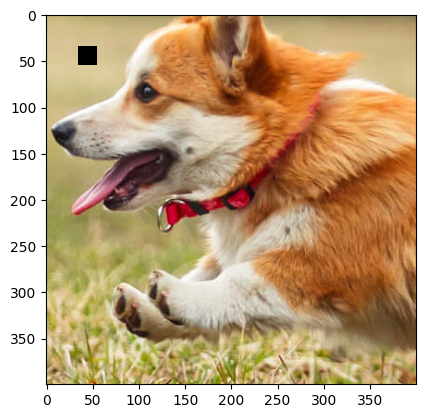

In [409]:
img_1c = img.clone().detach()
img_1c = img_1c.to(torch.float32)
img_1c[35:55, 35:55, :] = torch.nan
plt.imshow(img_1c/255)
print(img_1c[img_1c.isnan()].size())

In [410]:
img_array = img_1c

/tmp/ipykernel_6127/3352673191.py:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]
/tmp/ipykernel_6127/3352673191.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  red_values = torch.tensor(img_array[:, column_index, 0])
/tmp/ipykernel_6127/3352673191.py:9: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  green_values = torch.tensor(img_array[:, column_index, 1])
/tmp/ipykernel_6127/3352673191.py:11: UserWarning: To copy construct from a tensor, it is recommended to use

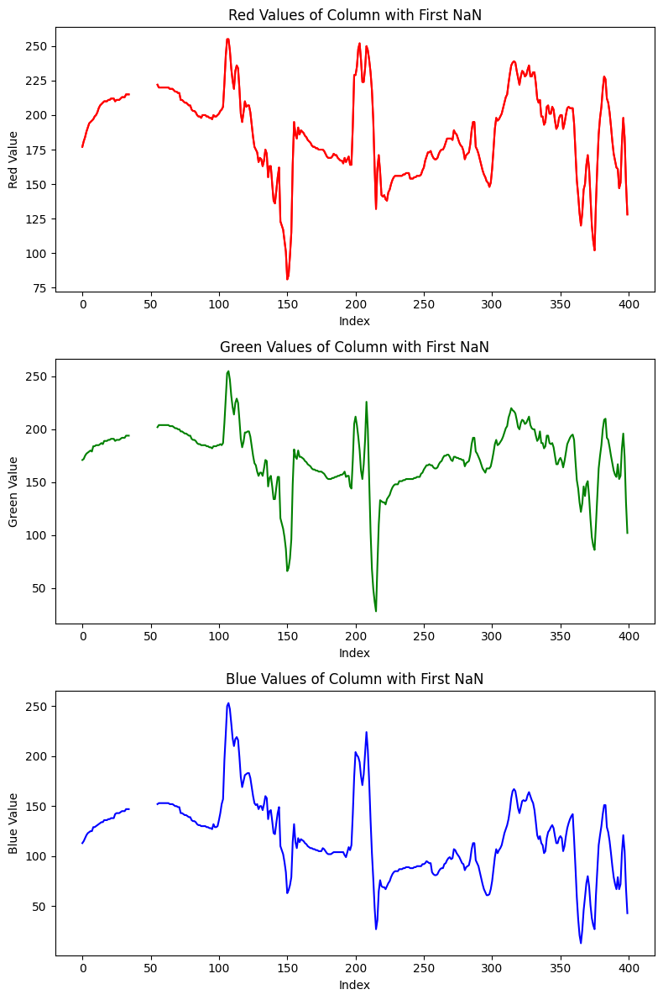

<Figure size 640x480 with 0 Axes>

In [411]:
import matplotlib.pyplot as plt

# Find the column index where the first NaN value occurs
column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]

# Get the red values of the column
red_values = torch.tensor(img_array[:, column_index, 0])
# Get the green values of the column
green_values = torch.tensor(img_array[:, column_index, 1])
# Get the blue values of the column
blue_values = torch.tensor(img_array[:, column_index, 2])

# Create subplots
fig, axs = plt.subplots(3, 1, figsize=(8, 12))

# Plot the red values
axs[0].plot(red_values, color='red')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')
# Plot the red values with missing values as black
axs[0].plot(red_values, color='red')
axs[0].scatter(torch.where(torch.isnan(red_values))[0], red_values[torch.isnan(red_values)], color='black')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')

# Plot the green values with missing values as black
axs[1].plot(green_values, color='green')
axs[1].scatter(torch.where(torch.isnan(green_values))[0], green_values[torch.isnan(green_values)], color='black')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values with missing values as black
axs[2].plot(blue_values, color='blue')
axs[2].scatter(torch.where(torch.isnan(blue_values))[0], blue_values[torch.isnan(blue_values)], color='black')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()

# Plot the green values
axs[1].plot(green_values, color='green')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values
axs[2].plot(blue_values, color='blue')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()


In [412]:
def factorize(A, k, device, lambda_reg):
    W = torch.randn(A.shape[0], k, dtype=torch.float32, device=device, requires_grad=True)
    H = torch.randn(k, A.shape[1], dtype=torch.float32, device=device, requires_grad=True)
    mask3 = ~torch.isnan(A)
    A_est = torch.matmul(W, H)
    error = torch.norm(A[mask3] - A_est[mask3])
    regularization = lambda_reg * (torch.norm(W) + torch.norm(H))
    loss = error + regularization

    optimizer = optim.SGD([W, H], lr=0.02)

    for i in range(5000):
        optimizer.zero_grad()

        A_est = torch.matmul(W, H)
        error = torch.norm(A[mask3] - A_est[mask3])
        regularization = lambda_reg * (torch.norm(W) + torch.norm(H))
        loss = error + regularization

        loss.backward()
        optimizer.step()

        error = torch.norm(A[mask3] - A_est[mask3])
        # print(error)

    return W, H



In [413]:
## for 1 colour train the model

A = img_array.clone().detach().to(torch.float32).to(device)
k = 180     # Here, k should be very very small than A.shape[0] and A.shape[1] 
lambda_reg = 0.12  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


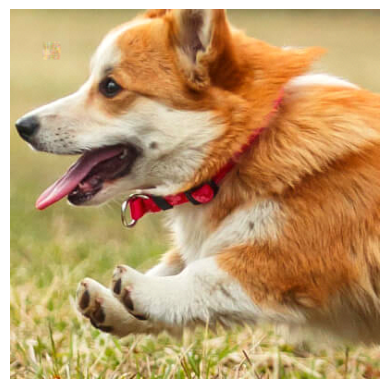

In [414]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


/tmp/ipykernel_6127/319164057.py:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]


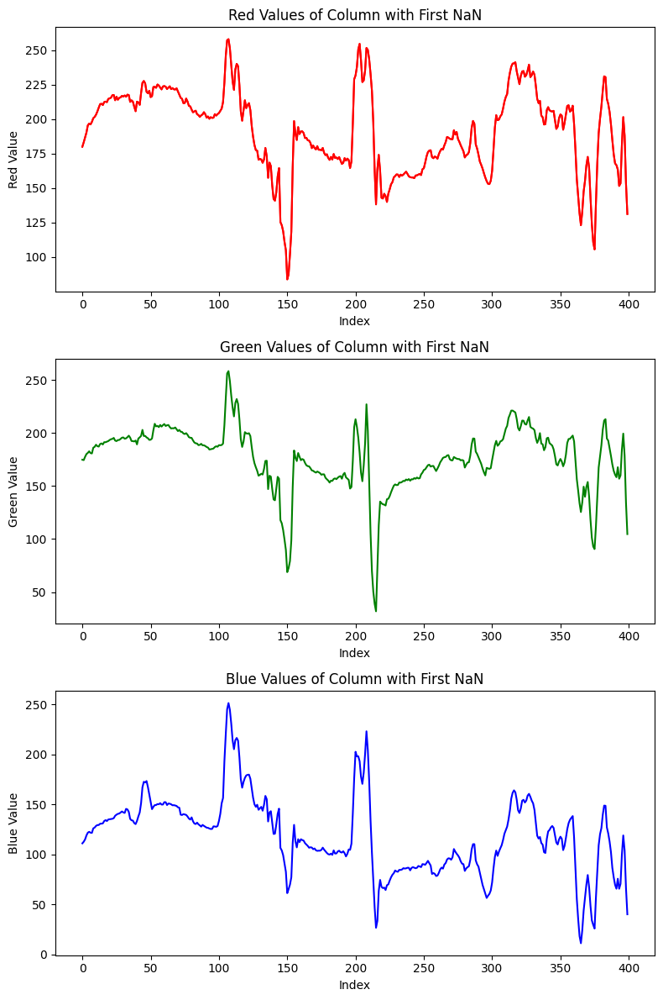

<Figure size 640x480 with 0 Axes>

In [415]:
import matplotlib.pyplot as plt

# Find the column index where the first NaN value occurs
column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]

# Get the red values of the column
red_values = (red_img[:, column_index]).cpu().detach().numpy()
# Get the green values of the column
green_values = (green_img[:, column_index]).cpu().detach().numpy()
# Get the blue values of the column
blue_values = (blue_img[:, column_index]).cpu().detach().numpy()

# Create subplots
fig, axs = plt.subplots(3, 1, figsize=(8, 12))

# Plot the red values
axs[0].plot(red_values, color='red')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')
# Plot the red values with missing values as black
axs[0].plot(red_values, color='red')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')

# Plot the green values with missing values as black
axs[1].plot(green_values, color='green')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values with missing values as black
axs[2].plot(blue_values, color='blue')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()

# Plot the green values
axs[1].plot(green_values, color='green')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values
axs[2].plot(blue_values, color='blue')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()


# Metrics:

In [416]:
import numpy as np

# Convert the predicted image (A) and the original image (img) to numpy arrays
predicted_image = final_img
original_image = img.detach().cpu().numpy()

# Calculate the squared difference between the predicted and original images
squared_diff = np.square(predicted_image - original_image)

# Calculate the mean squared difference
mean_squared_diff = np.mean(squared_diff)

# Calculate the RMSE by taking the square root of the mean squared difference
rmse = np.sqrt(mean_squared_diff)

# Print the RMSE
print("RMSE:", rmse)


RMSE: 2.8630636


In [417]:
import numpy as np

def calculate_psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

psnr = calculate_psnr(final_img, np.array(img))
print("Peak Signal-to-Noise Ratio (PSNR):", psnr)


Peak Signal-to-Noise Ratio (PSNR): 39.23689842224121


# For 2 colours

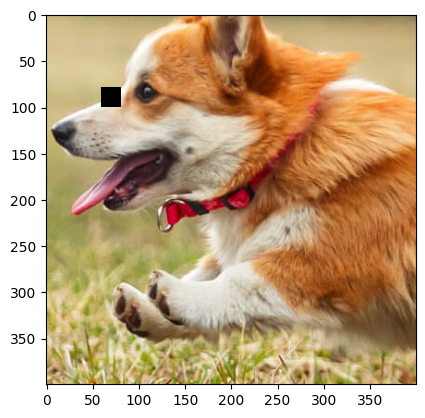

In [418]:
img_23c = img.clone().detach()
img_23c = img_23c.to(torch.float32)
img_23c[80:100, 60:80, :] = torch.nan
plt.imshow(img_23c/255)

In [419]:
img_array = img_23c

In [420]:
## for 2 colours
A = torch.tensor(img_array, dtype=torch.float32, device=device)
k = 200
lambda_reg = 0.14  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)

/tmp/ipykernel_6127/91293281.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(img_array, dtype=torch.float32, device=device)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


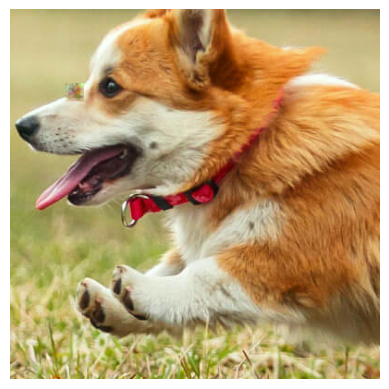

In [421]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


# Metrics:

In [422]:
import numpy as np

# Convert the predicted image (A) and the original image (img) to numpy arrays
predicted_image = final_img
original_image = img.detach().cpu().numpy()

# Calculate the squared difference between the predicted and original images
squared_diff = np.square(predicted_image - original_image)

# Calculate the mean squared difference
mean_squared_diff = np.mean(squared_diff)

# Calculate the RMSE by taking the square root of the mean squared difference
rmse = np.sqrt(mean_squared_diff)

# Print the RMSE
print("RMSE:", rmse)


RMSE: 4.670895


In [423]:
import numpy as np

def calculate_psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

psnr = calculate_psnr(final_img, np.array(img))
print("Peak Signal-to-Noise Ratio (PSNR):", psnr)


Peak Signal-to-Noise Ratio (PSNR): 34.931697845458984


# For 5 colours

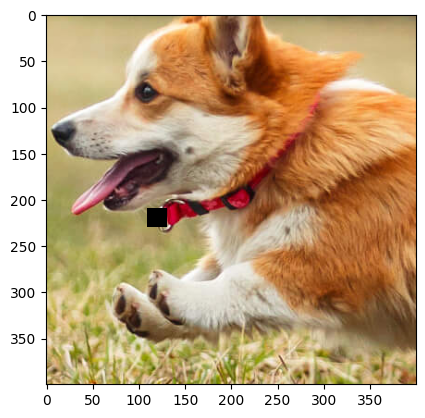

In [424]:
img_5c = img.clone().detach()
img_5c = img_5c.to(torch.float32)
img_5c[210:230, 110:130, :] = torch.nan
plt.imshow(img_5c/255)

In [425]:
img_array = img_5c

In [426]:
# for 5 colour
A = torch.tensor(img_array, dtype=torch.float32, device=device)
k = 100
lambda_reg = 0.09  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)


/tmp/ipykernel_6127/3159195331.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(img_array, dtype=torch.float32, device=device)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


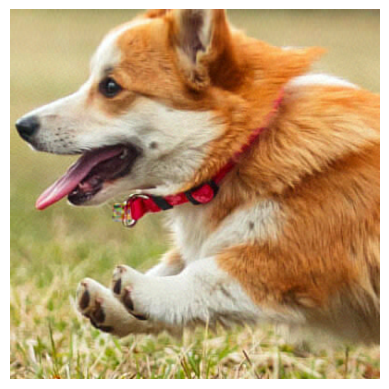

In [427]:
# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


# Metrics:

In [428]:
import numpy as np

# Convert the predicted image (A) and the original image (img) to numpy arrays
predicted_image = final_img
original_image = img.detach().cpu().numpy()

# Calculate the squared difference between the predicted and original images
squared_diff = np.square(predicted_image - original_image)

# Calculate the mean squared difference
mean_squared_diff = np.mean(squared_diff)

# Calculate the RMSE by taking the square root of the mean squared difference
rmse = np.sqrt(mean_squared_diff)

# Print the RMSE
print("RMSE:", rmse)


RMSE: 4.075016


In [429]:
import numpy as np

def calculate_psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

psnr = calculate_psnr(final_img, np.array(img))
print("Peak Signal-to-Noise Ratio (PSNR):", psnr)


Peak Signal-to-Noise Ratio (PSNR): 36.19307518005371


# For N = 40

# For 1 Colour

torch.Size([4800])


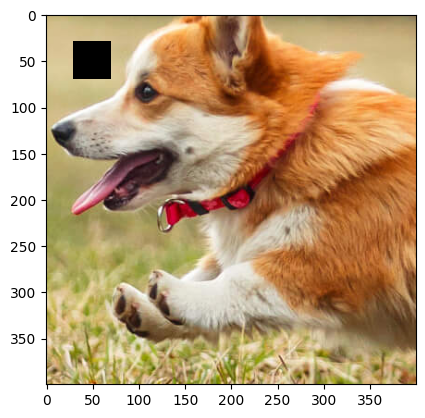

In [430]:
img_1c = img.clone().detach()
img_1c = img_1c.to(torch.float32)
img_1c[30:70, 30:70, :] = torch.nan
plt.imshow(img_1c/255)
print(img_1c[img_1c.isnan()].size())

In [431]:
img_array = img_1c

/tmp/ipykernel_6127/3352673191.py:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]
/tmp/ipykernel_6127/3352673191.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  red_values = torch.tensor(img_array[:, column_index, 0])
/tmp/ipykernel_6127/3352673191.py:9: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  green_values = torch.tensor(img_array[:, column_index, 1])
/tmp/ipykernel_6127/3352673191.py:11: UserWarning: To copy construct from a tensor, it is recommended to use

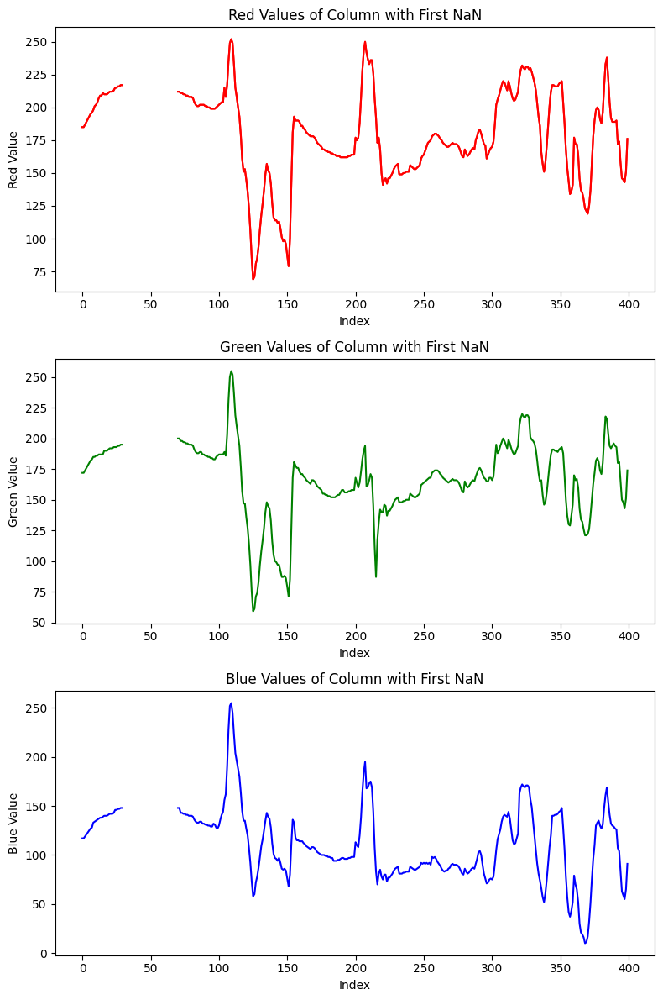

<Figure size 640x480 with 0 Axes>

In [432]:
import matplotlib.pyplot as plt

# Find the column index where the first NaN value occurs
column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]

# Get the red values of the column
red_values = torch.tensor(img_array[:, column_index, 0])
# Get the green values of the column
green_values = torch.tensor(img_array[:, column_index, 1])
# Get the blue values of the column
blue_values = torch.tensor(img_array[:, column_index, 2])

# Create subplots
fig, axs = plt.subplots(3, 1, figsize=(8, 12))

# Plot the red values
axs[0].plot(red_values, color='red')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')
# Plot the red values with missing values as black
axs[0].plot(red_values, color='red')
axs[0].scatter(torch.where(torch.isnan(red_values))[0], red_values[torch.isnan(red_values)], color='black')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')

# Plot the green values with missing values as black
axs[1].plot(green_values, color='green')
axs[1].scatter(torch.where(torch.isnan(green_values))[0], green_values[torch.isnan(green_values)], color='black')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values with missing values as black
axs[2].plot(blue_values, color='blue')
axs[2].scatter(torch.where(torch.isnan(blue_values))[0], blue_values[torch.isnan(blue_values)], color='black')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()

# Plot the green values
axs[1].plot(green_values, color='green')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values
axs[2].plot(blue_values, color='blue')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()


In [433]:
def factorize(A, k, device, lambda_reg):
    W = torch.randn(A.shape[0], k, dtype=torch.float32, device=device, requires_grad=True)
    H = torch.randn(k, A.shape[1], dtype=torch.float32, device=device, requires_grad=True)
    mask3 = ~torch.isnan(A)
    A_est = torch.matmul(W, H)
    error = torch.norm(A[mask3] - A_est[mask3])
    regularization = lambda_reg * (torch.norm(W) + torch.norm(H))
    loss = error + regularization

    optimizer = optim.SGD([W, H], lr=0.02)

    for i in range(5000):
        optimizer.zero_grad()

        A_est = torch.matmul(W, H)
        error = torch.norm(A[mask3] - A_est[mask3])
        regularization = lambda_reg * (torch.norm(W) + torch.norm(H))
        loss = error + regularization

        loss.backward()
        optimizer.step()

        error = torch.norm(A[mask3] - A_est[mask3])
        # print(error)

    return W, H



In [434]:
## for 1 colour train the model

A = img_array.clone().detach().to(torch.float32).to(device)
k = 180     # Here, k should be very very small than A.shape[0] and A.shape[1] 
lambda_reg = 0.12  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


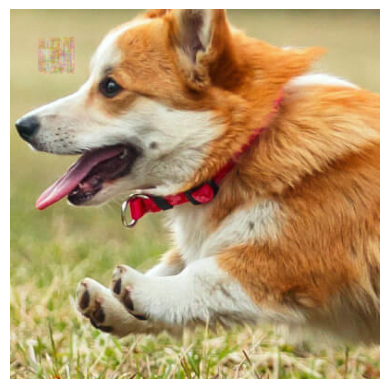

In [435]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


/tmp/ipykernel_6127/319164057.py:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]


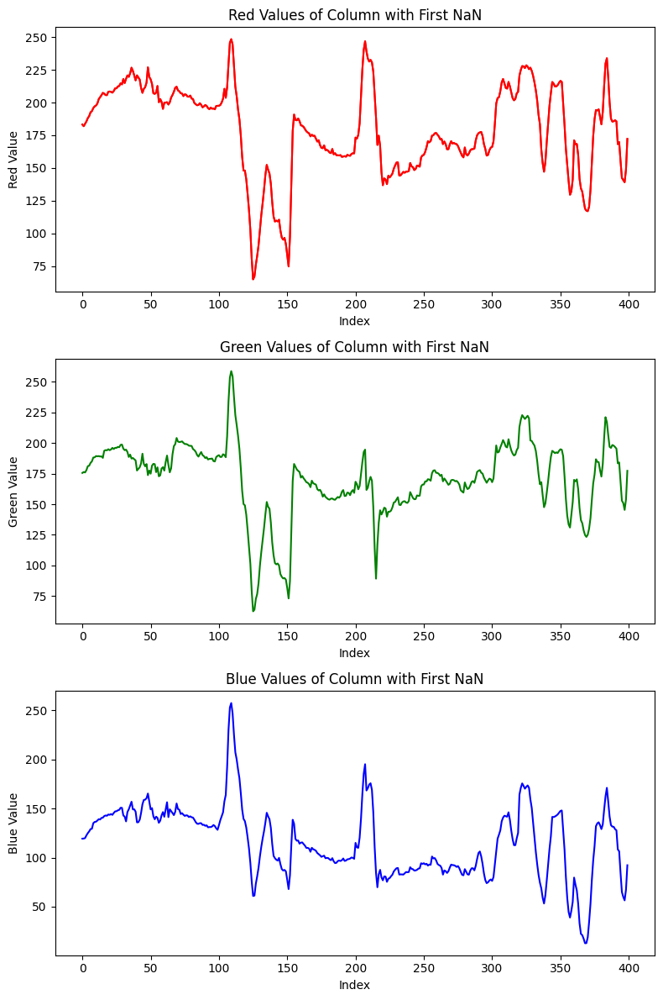

<Figure size 640x480 with 0 Axes>

In [436]:
import matplotlib.pyplot as plt

# Find the column index where the first NaN value occurs
column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]

# Get the red values of the column
red_values = (red_img[:, column_index]).cpu().detach().numpy()
# Get the green values of the column
green_values = (green_img[:, column_index]).cpu().detach().numpy()
# Get the blue values of the column
blue_values = (blue_img[:, column_index]).cpu().detach().numpy()

# Create subplots
fig, axs = plt.subplots(3, 1, figsize=(8, 12))

# Plot the red values
axs[0].plot(red_values, color='red')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')
# Plot the red values with missing values as black
axs[0].plot(red_values, color='red')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')

# Plot the green values with missing values as black
axs[1].plot(green_values, color='green')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values with missing values as black
axs[2].plot(blue_values, color='blue')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()

# Plot the green values
axs[1].plot(green_values, color='green')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values
axs[2].plot(blue_values, color='blue')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()


# Metrics:

In [437]:
import numpy as np

# Convert the predicted image (A) and the original image (img) to numpy arrays
predicted_image = final_img
original_image = img.detach().cpu().numpy()

# Calculate the squared difference between the predicted and original images
squared_diff = np.square(predicted_image - original_image)

# Calculate the mean squared difference
mean_squared_diff = np.mean(squared_diff)

# Calculate the RMSE by taking the square root of the mean squared difference
rmse = np.sqrt(mean_squared_diff)

# Print the RMSE
print("RMSE:", rmse)


RMSE: 3.721393


In [438]:
import numpy as np

def calculate_psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

psnr = calculate_psnr(final_img, np.array(img))
print("Peak Signal-to-Noise Ratio (PSNR):", psnr)


Peak Signal-to-Noise Ratio (PSNR): 36.92736625671387


# For 2 colours

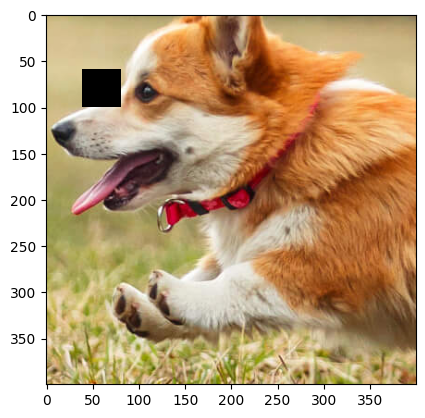

In [439]:
img_23c = img.clone().detach()
img_23c = img_23c.to(torch.float32)
img_23c[60:100, 40:80, :] = torch.nan
plt.imshow(img_23c/255)

In [440]:
img_array = img_23c

In [441]:
## for 2 colours
A = torch.tensor(img_array, dtype=torch.float32, device=device)
k = 200
lambda_reg = 0.14  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)

/tmp/ipykernel_6127/91293281.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(img_array, dtype=torch.float32, device=device)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


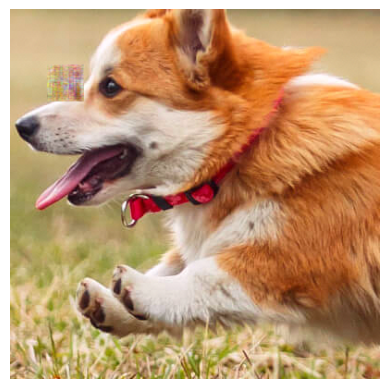

In [442]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


# Metrics:

In [443]:
import numpy as np

# Convert the predicted image (A) and the original image (img) to numpy arrays
predicted_image = final_img
original_image = img.detach().cpu().numpy()

# Calculate the squared difference between the predicted and original images
squared_diff = np.square(predicted_image - original_image)

# Calculate the mean squared difference
mean_squared_diff = np.mean(squared_diff)

# Calculate the RMSE by taking the square root of the mean squared difference
rmse = np.sqrt(mean_squared_diff)

# Print the RMSE
print("RMSE:", rmse)


RMSE: 5.4402313


In [444]:
import numpy as np

def calculate_psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

psnr = calculate_psnr(final_img, np.array(img))
print("Peak Signal-to-Noise Ratio (PSNR):", psnr)


Peak Signal-to-Noise Ratio (PSNR): 33.64467144012451


# For 5 colours

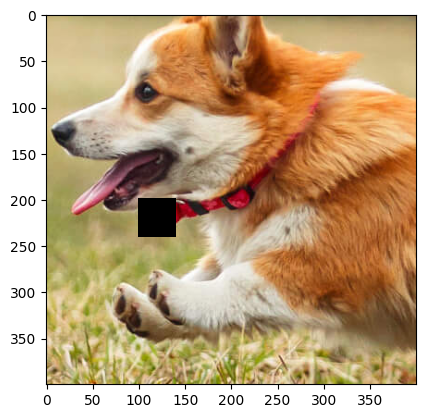

In [445]:
img_5c = img.clone().detach()
img_5c = img_5c.to(torch.float32)
img_5c[200:240, 100:140, :] = torch.nan
plt.imshow(img_5c/255)

In [446]:
img_array = img_5c

In [447]:
# for 5 colour
A = torch.tensor(img_array, dtype=torch.float32, device=device)
k = 100
lambda_reg = 0.09  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)


/tmp/ipykernel_6127/3159195331.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(img_array, dtype=torch.float32, device=device)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


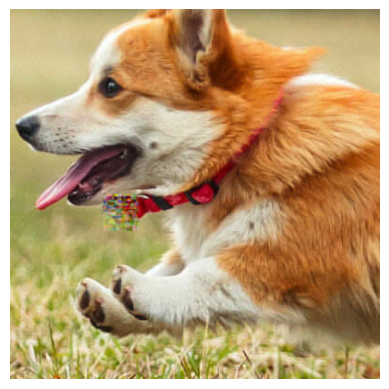

In [448]:
# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


# Metrics:

In [449]:
import numpy as np

# Convert the predicted image (A) and the original image (img) to numpy arrays
predicted_image = final_img
original_image = img.detach().cpu().numpy()

# Calculate the squared difference between the predicted and original images
squared_diff = np.square(predicted_image - original_image)

# Calculate the mean squared difference
mean_squared_diff = np.mean(squared_diff)

# Calculate the RMSE by taking the square root of the mean squared difference
rmse = np.sqrt(mean_squared_diff)

# Print the RMSE
print("RMSE:", rmse)


RMSE: 5.9327173


In [450]:
import numpy as np

def calculate_psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

psnr = calculate_psnr(final_img, np.array(img))
print("Peak Signal-to-Noise Ratio (PSNR):", psnr)


Peak Signal-to-Noise Ratio (PSNR): 32.896320819854736


# For N = 60

# For 1 Colour

torch.Size([10800])


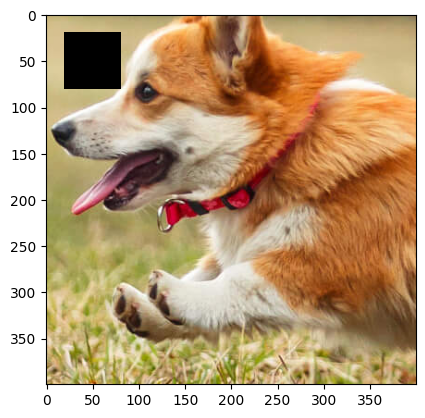

In [451]:
img_1c = img.clone().detach()
img_1c = img_1c.to(torch.float32)
img_1c[20:80, 20:80, :] = torch.nan
plt.imshow(img_1c/255)
print(img_1c[img_1c.isnan()].size())

In [452]:
img_array = img_1c

/tmp/ipykernel_6127/3352673191.py:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]
/tmp/ipykernel_6127/3352673191.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  red_values = torch.tensor(img_array[:, column_index, 0])
/tmp/ipykernel_6127/3352673191.py:9: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  green_values = torch.tensor(img_array[:, column_index, 1])
/tmp/ipykernel_6127/3352673191.py:11: UserWarning: To copy construct from a tensor, it is recommended to use

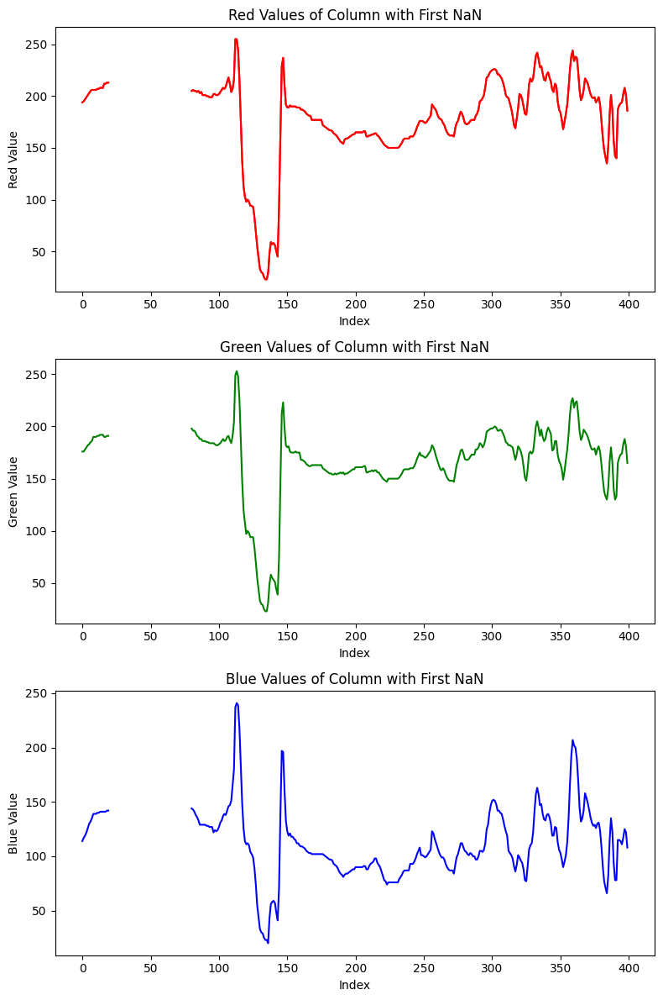

<Figure size 640x480 with 0 Axes>

In [453]:
import matplotlib.pyplot as plt

# Find the column index where the first NaN value occurs
column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]

# Get the red values of the column
red_values = torch.tensor(img_array[:, column_index, 0])
# Get the green values of the column
green_values = torch.tensor(img_array[:, column_index, 1])
# Get the blue values of the column
blue_values = torch.tensor(img_array[:, column_index, 2])

# Create subplots
fig, axs = plt.subplots(3, 1, figsize=(8, 12))

# Plot the red values
axs[0].plot(red_values, color='red')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')
# Plot the red values with missing values as black
axs[0].plot(red_values, color='red')
axs[0].scatter(torch.where(torch.isnan(red_values))[0], red_values[torch.isnan(red_values)], color='black')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')

# Plot the green values with missing values as black
axs[1].plot(green_values, color='green')
axs[1].scatter(torch.where(torch.isnan(green_values))[0], green_values[torch.isnan(green_values)], color='black')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values with missing values as black
axs[2].plot(blue_values, color='blue')
axs[2].scatter(torch.where(torch.isnan(blue_values))[0], blue_values[torch.isnan(blue_values)], color='black')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()

# Plot the green values
axs[1].plot(green_values, color='green')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values
axs[2].plot(blue_values, color='blue')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()


In [454]:
def factorize(A, k, device, lambda_reg):
    W = torch.randn(A.shape[0], k, dtype=torch.float32, device=device, requires_grad=True)
    H = torch.randn(k, A.shape[1], dtype=torch.float32, device=device, requires_grad=True)
    mask3 = ~torch.isnan(A)
    A_est = torch.matmul(W, H)
    error = torch.norm(A[mask3] - A_est[mask3])
    regularization = lambda_reg * (torch.norm(W) + torch.norm(H))
    loss = error + regularization # Here in normal linear regression we do not use
    #regularization but for better accuracy we have used this term here but in
    #another file we have not used this term

    optimizer = optim.SGD([W, H], lr=0.02)

    for i in range(5000):
        optimizer.zero_grad()

        A_est = torch.matmul(W, H)
        error = torch.norm(A[mask3] - A_est[mask3])
        regularization = lambda_reg * (torch.norm(W) + torch.norm(H))
        loss = error + regularization

        loss.backward()
        optimizer.step()

        error = torch.norm(A[mask3] - A_est[mask3])
        # print(error)

    return W, H



In [455]:
## for 1 colour train the model

A = img_array.clone().detach().to(torch.float32).to(device)
k = 180     # Here, k should be very very small than A.shape[0] and A.shape[1] 
lambda_reg = 0.12  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


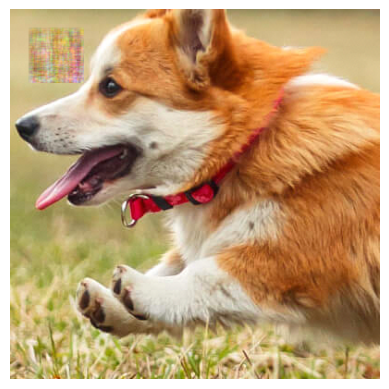

In [456]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


/tmp/ipykernel_6127/319164057.py:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]


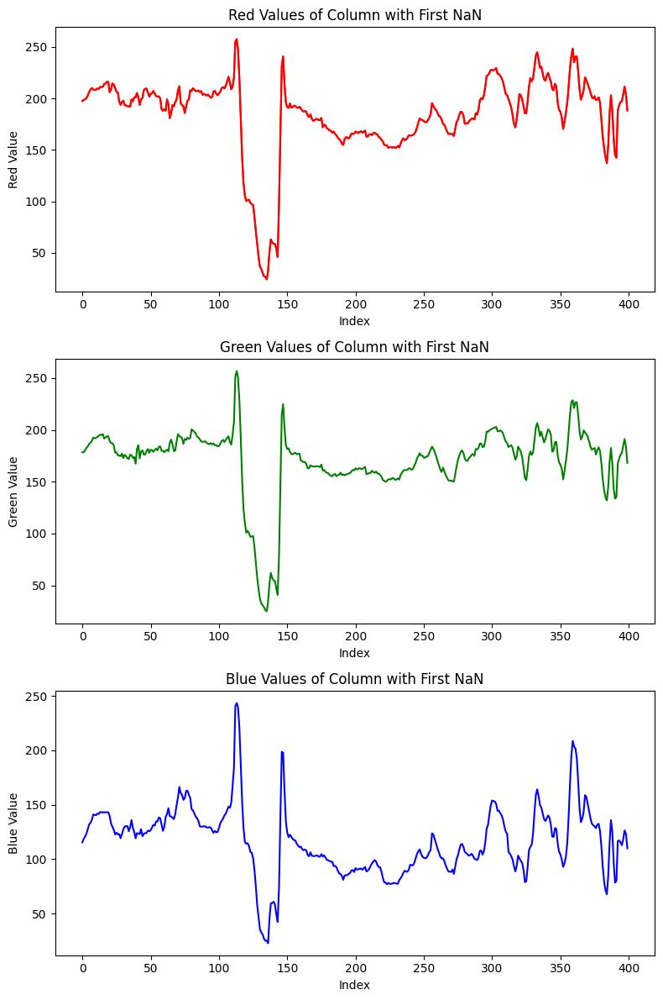

<Figure size 640x480 with 0 Axes>

In [457]:
import matplotlib.pyplot as plt

# Find the column index where the first NaN value occurs
column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]

# Get the red values of the column
red_values = (red_img[:, column_index]).cpu().detach().numpy()
# Get the green values of the column
green_values = (green_img[:, column_index]).cpu().detach().numpy()
# Get the blue values of the column
blue_values = (blue_img[:, column_index]).cpu().detach().numpy()

# Create subplots
fig, axs = plt.subplots(3, 1, figsize=(8, 12))

# Plot the red values
axs[0].plot(red_values, color='red')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')
# Plot the red values with missing values as black
axs[0].plot(red_values, color='red')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')

# Plot the green values with missing values as black
axs[1].plot(green_values, color='green')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values with missing values as black
axs[2].plot(blue_values, color='blue')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()

# Plot the green values
axs[1].plot(green_values, color='green')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values
axs[2].plot(blue_values, color='blue')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()


# Metrics:

In [458]:
import numpy as np

# Convert the predicted image (A) and the original image (img) to numpy arrays
predicted_image = final_img
original_image = img.detach().cpu().numpy()

# Calculate the squared difference between the predicted and original images
squared_diff = np.square(predicted_image - original_image)

# Calculate the mean squared difference
mean_squared_diff = np.mean(squared_diff)

# Calculate the RMSE by taking the square root of the mean squared difference
rmse = np.sqrt(mean_squared_diff)

# Print the RMSE
print("RMSE:", rmse)


RMSE: 5.544824


In [459]:
import numpy as np

def calculate_psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

psnr = calculate_psnr(final_img, np.array(img))
print("Peak Signal-to-Noise Ratio (PSNR):", psnr)


Peak Signal-to-Noise Ratio (PSNR): 33.55407476425171


# For 2 colours

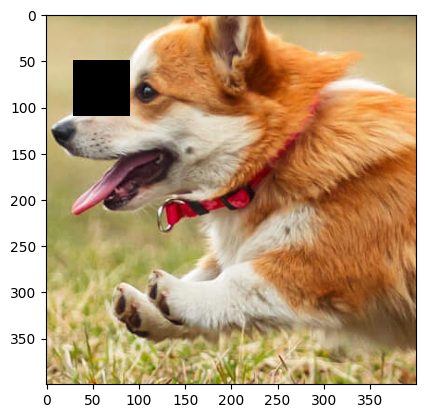

In [460]:
img_23c = img.clone().detach()
img_23c = img_23c.to(torch.float32)
img_23c[50:110, 30:90, :] = torch.nan
plt.imshow(img_23c/255)

In [461]:
img_array = img_23c

In [462]:
## for 2 colours
A = torch.tensor(img_array, dtype=torch.float32, device=device)
k = 200
lambda_reg = 0.14  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)

/tmp/ipykernel_6127/91293281.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(img_array, dtype=torch.float32, device=device)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


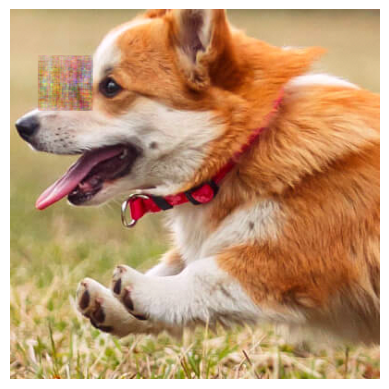

In [463]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


# Metrics:

In [464]:
import numpy as np

# Convert the predicted image (A) and the original image (img) to numpy arrays
predicted_image = final_img
original_image = img.detach().cpu().numpy()

# Calculate the squared difference between the predicted and original images
squared_diff = np.square(predicted_image - original_image)

# Calculate the mean squared difference
mean_squared_diff = np.mean(squared_diff)

# Calculate the RMSE by taking the square root of the mean squared difference
rmse = np.sqrt(mean_squared_diff)

# Print the RMSE
print("RMSE:", rmse)


RMSE: 9.256909


In [465]:
import numpy as np

def calculate_psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

psnr = calculate_psnr(final_img, np.array(img))
print("Peak Signal-to-Noise Ratio (PSNR):", psnr)


Peak Signal-to-Noise Ratio (PSNR): 29.037623405456543


# For 5 colours

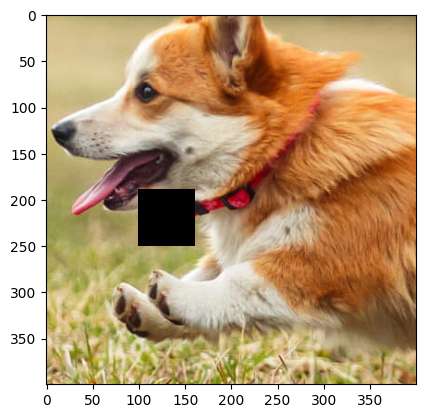

In [466]:
img_5c = img.clone().detach()
img_5c = img_5c.to(torch.float32)
img_5c[190:250, 100:160, :] = torch.nan
plt.imshow(img_5c/255)

In [467]:
img_array = img_5c

In [468]:
# for 5 colour
A = torch.tensor(img_array, dtype=torch.float32, device=device)
k = 100
lambda_reg = 0.09  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)


/tmp/ipykernel_6127/3159195331.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(img_array, dtype=torch.float32, device=device)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


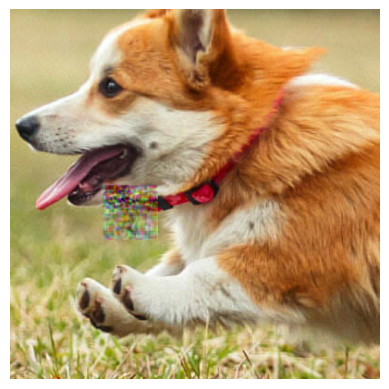

In [469]:
# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


# Metrics:

In [470]:
import numpy as np

# Convert the predicted image (A) and the original image (img) to numpy arrays
predicted_image = final_img
original_image = img.detach().cpu().numpy()

# Calculate the squared difference between the predicted and original images
squared_diff = np.square(predicted_image - original_image)

# Calculate the mean squared difference
mean_squared_diff = np.mean(squared_diff)

# Calculate the RMSE by taking the square root of the mean squared difference
rmse = np.sqrt(mean_squared_diff)

# Print the RMSE
print("RMSE:", rmse)


RMSE: 8.3303


In [471]:
import numpy as np

def calculate_psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

psnr = calculate_psnr(final_img, np.array(img))
print("Peak Signal-to-Noise Ratio (PSNR):", psnr)


Peak Signal-to-Noise Ratio (PSNR): 29.91827964782715


# For N = 80

torch.Size([19200])


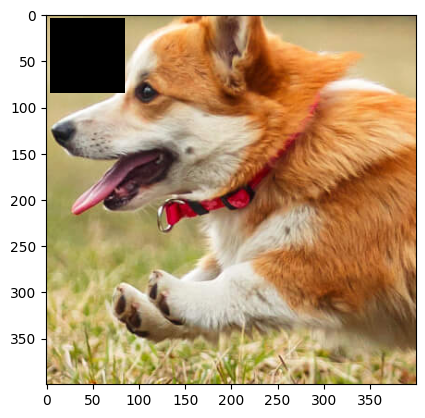

In [472]:
img_1c = img.clone().detach()
img_1c = img_1c.to(torch.float32)
img_1c[5:85, 5:85, :] = torch.nan
plt.imshow(img_1c/255)
print(img_1c[img_1c.isnan()].size())

In [473]:
img_array = img_1c

/tmp/ipykernel_6127/3352673191.py:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]
/tmp/ipykernel_6127/3352673191.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  red_values = torch.tensor(img_array[:, column_index, 0])
/tmp/ipykernel_6127/3352673191.py:9: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  green_values = torch.tensor(img_array[:, column_index, 1])
/tmp/ipykernel_6127/3352673191.py:11: UserWarning: To copy construct from a tensor, it is recommended to use

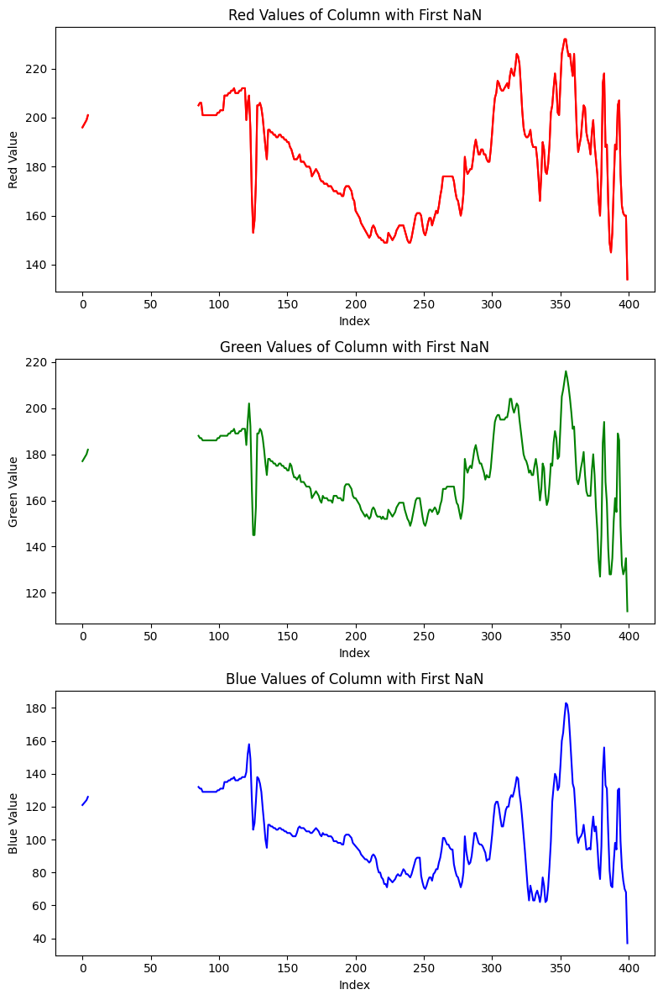

<Figure size 640x480 with 0 Axes>

In [474]:
import matplotlib.pyplot as plt

# Find the column index where the first NaN value occurs
column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]

# Get the red values of the column
red_values = torch.tensor(img_array[:, column_index, 0])
# Get the green values of the column
green_values = torch.tensor(img_array[:, column_index, 1])
# Get the blue values of the column
blue_values = torch.tensor(img_array[:, column_index, 2])

# Create subplots
fig, axs = plt.subplots(3, 1, figsize=(8, 12))

# Plot the red values
axs[0].plot(red_values, color='red')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')
# Plot the red values with missing values as black
axs[0].plot(red_values, color='red')
axs[0].scatter(torch.where(torch.isnan(red_values))[0], red_values[torch.isnan(red_values)], color='black')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')

# Plot the green values with missing values as black
axs[1].plot(green_values, color='green')
axs[1].scatter(torch.where(torch.isnan(green_values))[0], green_values[torch.isnan(green_values)], color='black')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values with missing values as black
axs[2].plot(blue_values, color='blue')
axs[2].scatter(torch.where(torch.isnan(blue_values))[0], blue_values[torch.isnan(blue_values)], color='black')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()

# Plot the green values
axs[1].plot(green_values, color='green')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values
axs[2].plot(blue_values, color='blue')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()


In [475]:
def factorize(A, k, device, lambda_reg):
    W = torch.randn(A.shape[0], k, dtype=torch.float32, device=device, requires_grad=True)
    H = torch.randn(k, A.shape[1], dtype=torch.float32, device=device, requires_grad=True)
    mask3 = ~torch.isnan(A)
    A_est = torch.matmul(W, H)
    error = torch.norm(A[mask3] - A_est[mask3])
    regularization = lambda_reg * (torch.norm(W) + torch.norm(H))
    loss = error + regularization

    optimizer = optim.SGD([W, H], lr=0.02) # here, we can use Adam optimizer also

    for i in range(5000):
        optimizer.zero_grad()

        A_est = torch.matmul(W, H)
        error = torch.norm(A[mask3] - A_est[mask3])
        regularization = lambda_reg * (torch.norm(W) + torch.norm(H))
        loss = error + regularization

        loss.backward()
        optimizer.step()

        error = torch.norm(A[mask3] - A_est[mask3])
        # print(error)

    return W, H



In [476]:
## for 1 colour train the model

A = img_array.clone().detach().to(torch.float32).to(device)
k = 180     # Here, k should be very very small than A.shape[0] and A.shape[1] 
lambda_reg = 0.12  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


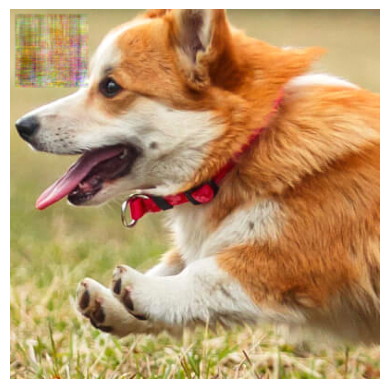

In [477]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


/tmp/ipykernel_6127/319164057.py:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]


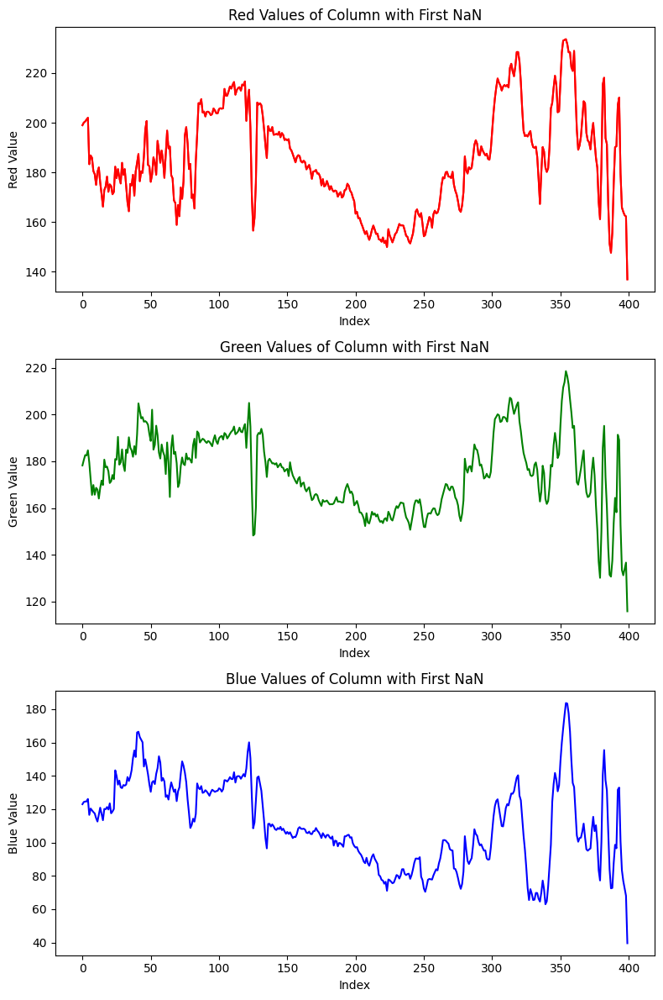

<Figure size 640x480 with 0 Axes>

In [478]:
import matplotlib.pyplot as plt

# Find the column index where the first NaN value occurs
column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]

# Get the red values of the column
red_values = (red_img[:, column_index]).cpu().detach().numpy()
# Get the green values of the column
green_values = (green_img[:, column_index]).cpu().detach().numpy()
# Get the blue values of the column
blue_values = (blue_img[:, column_index]).cpu().detach().numpy()

# Create subplots
fig, axs = plt.subplots(3, 1, figsize=(8, 12))

# Plot the red values
axs[0].plot(red_values, color='red')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')
# Plot the red values with missing values as black
axs[0].plot(red_values, color='red')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')

# Plot the green values with missing values as black
axs[1].plot(green_values, color='green')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values with missing values as black
axs[2].plot(blue_values, color='blue')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()

# Plot the green values
axs[1].plot(green_values, color='green')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values
axs[2].plot(blue_values, color='blue')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()


# Metrics:

In [479]:
import numpy as np

# Convert the predicted image (A) and the original image (img) to numpy arrays
predicted_image = final_img
original_image = img.detach().cpu().numpy()

# Calculate the squared difference between the predicted and original images
squared_diff = np.square(predicted_image - original_image)

# Calculate the mean squared difference
mean_squared_diff = np.mean(squared_diff)

# Calculate the RMSE by taking the square root of the mean squared difference
rmse = np.sqrt(mean_squared_diff)

# Print the RMSE
print("RMSE:", rmse)


RMSE: 9.531432


In [480]:
import numpy as np

def calculate_psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

psnr = calculate_psnr(final_img, np.array(img))
print("Peak Signal-to-Noise Ratio (PSNR):", psnr)


Peak Signal-to-Noise Ratio (PSNR): 29.096851348876953


# For 2 colours

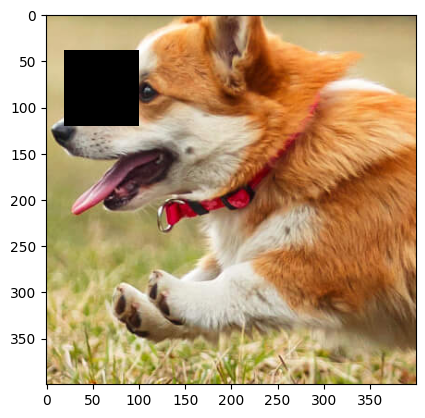

In [481]:
img_23c = img.clone().detach()
img_23c = img_23c.to(torch.float32)
img_23c[40:120, 20:100, :] = torch.nan
plt.imshow(img_23c/255)

In [482]:
img_array = img_23c

In [483]:
## for 2 colours
A = torch.tensor(img_array, dtype=torch.float32, device=device)
k = 200
lambda_reg = 0.14  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)

/tmp/ipykernel_6127/91293281.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(img_array, dtype=torch.float32, device=device)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


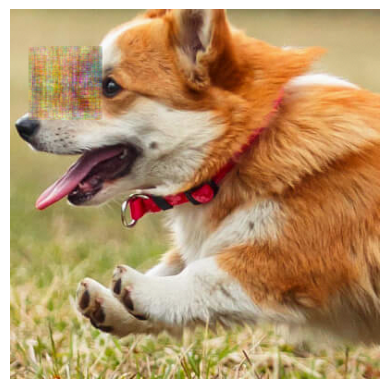

In [484]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


# Metrics:

In [485]:
import numpy as np

# Convert the predicted image (A) and the original image (img) to numpy arrays
predicted_image = final_img
original_image = img.detach().cpu().numpy()

# Calculate the squared difference between the predicted and original images
squared_diff = np.square(predicted_image - original_image)

# Calculate the mean squared difference
mean_squared_diff = np.mean(squared_diff)

# Calculate the RMSE by taking the square root of the mean squared difference
rmse = np.sqrt(mean_squared_diff)

# Print the RMSE
print("RMSE:", rmse)


RMSE: 12.882102


In [486]:
import numpy as np

def calculate_psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

psnr = calculate_psnr(final_img, np.array(img))
print("Peak Signal-to-Noise Ratio (PSNR):", psnr)


Peak Signal-to-Noise Ratio (PSNR): 25.957298278808594


# For 5 colours

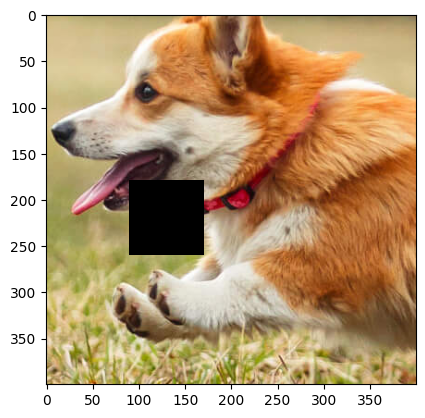

In [487]:
img_5c = img.clone().detach()
img_5c = img_5c.to(torch.float32)
img_5c[180:260, 90:170, :] = torch.nan
plt.imshow(img_5c/255)

In [488]:
img_array = img_5c

In [489]:
# for 5 colour
A = torch.tensor(img_array, dtype=torch.float32, device=device)
k = 100
lambda_reg = 0.09  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)


/tmp/ipykernel_6127/3159195331.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(img_array, dtype=torch.float32, device=device)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


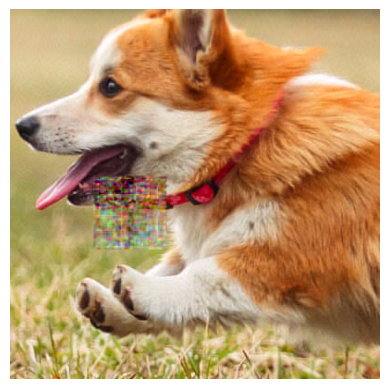

In [490]:
# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


# Metrics:

In [491]:
import numpy as np

# Convert the predicted image (A) and the original image (img) to numpy arrays
predicted_image = final_img
original_image = img.detach().cpu().numpy()

# Calculate the squared difference between the predicted and original images
squared_diff = np.square(predicted_image - original_image)

# Calculate the mean squared difference
mean_squared_diff = np.mean(squared_diff)

# Calculate the RMSE by taking the square root of the mean squared difference
rmse = np.sqrt(mean_squared_diff)

# Print the RMSE
print("RMSE:", rmse)


RMSE: 10.882671


In [492]:
import numpy as np

def calculate_psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

psnr = calculate_psnr(final_img, np.array(img))
print("Peak Signal-to-Noise Ratio (PSNR):", psnr)


Peak Signal-to-Noise Ratio (PSNR): 28.46806049346924


# Part 3

In [8]:
def least_squares(B, A):
    B = B.reshape(B.shape[0], 1)
    mask = ~torch.isnan(B)
    if (B.isnan().any()):
        A = A[torch.squeeze(mask)]
        B = B[torch.squeeze(mask)]

    return torch.linalg.lstsq(A, B, rcond=None).solution


def factorize(A, k, device, _):
    # Initialize W and H with random values between 0 and 255
    W = torch.randint(0, 256, (A.shape[0], k), dtype=torch.float32, device=device)
    H = torch.randint(0, 256, (k, A.shape[1]), dtype=torch.float32, device=device)

    for i in range(2):
        # Update H_n
        for i in range(A.shape[1]):
            A_col = A[:, i]
            H[:, i] = least_squares(A_col, W).reshape(k)
        if (H.isnan().any()) or (W.isnan().any()):
            print("H or W has NaN")
            raise ValueError
        # Update W_n
        for i in range(A.shape[0]):
            A_T_col = A[i, :]
            W[i, :] = least_squares(A_T_col, H.T).reshape(k)

    return W, H

# For N = 30

# For 1 Colour

torch.Size([2700])


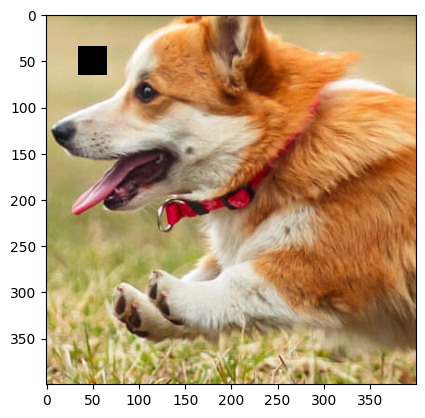

In [49]:
img_1c = img.clone().detach()
img_1c = img_1c.to(torch.float32)
img_1c[35:65, 35:65, :] = torch.nan
plt.imshow(img_1c/255)
print(img_1c[img_1c.isnan()].size())

In [50]:
img_array = img_1c

/tmp/ipykernel_4503/3352673191.py:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]
/tmp/ipykernel_4503/3352673191.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  red_values = torch.tensor(img_array[:, column_index, 0])
/tmp/ipykernel_4503/3352673191.py:9: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  green_values = torch.tensor(img_array[:, column_index, 1])
/tmp/ipykernel_4503/3352673191.py:11: UserWarning: To copy construct from a tensor, it is recommended to use

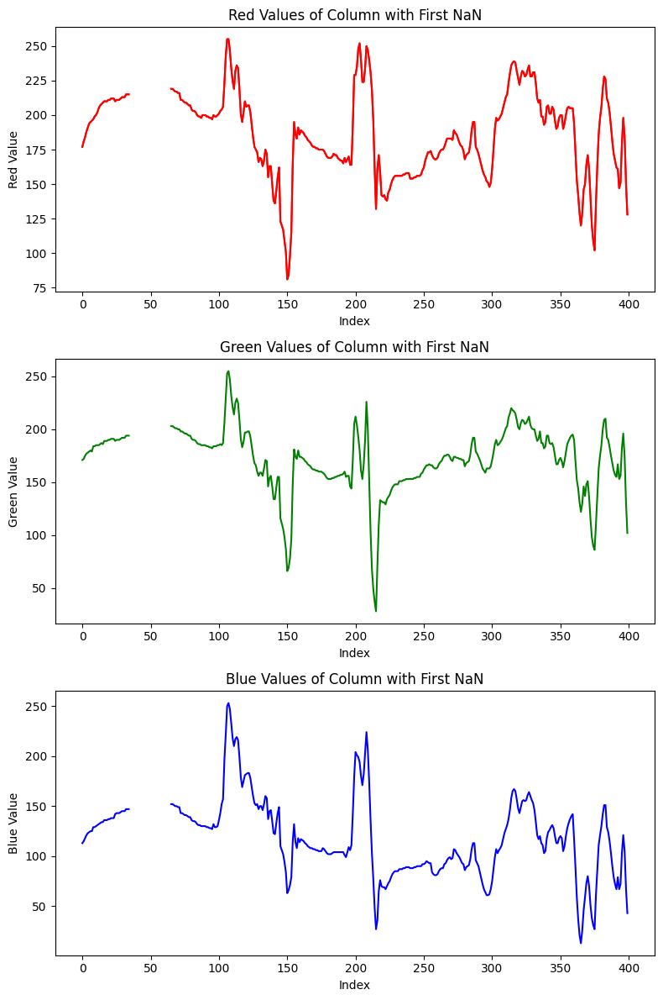

<Figure size 640x480 with 0 Axes>

In [51]:
import matplotlib.pyplot as plt

# Find the column index where the first NaN value occurs
column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]

# Get the red values of the column
red_values = torch.tensor(img_array[:, column_index, 0])
# Get the green values of the column
green_values = torch.tensor(img_array[:, column_index, 1])
# Get the blue values of the column
blue_values = torch.tensor(img_array[:, column_index, 2])

# Create subplots
fig, axs = plt.subplots(3, 1, figsize=(8, 12))

# Plot the red values
axs[0].plot(red_values, color='red')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')
# Plot the red values with missing values as black
axs[0].plot(red_values, color='red')
axs[0].scatter(torch.where(torch.isnan(red_values))[0], red_values[torch.isnan(red_values)], color='black')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')

# Plot the green values with missing values as black
axs[1].plot(green_values, color='green')
axs[1].scatter(torch.where(torch.isnan(green_values))[0], green_values[torch.isnan(green_values)], color='black')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values with missing values as black
axs[2].plot(blue_values, color='blue')
axs[2].scatter(torch.where(torch.isnan(blue_values))[0], blue_values[torch.isnan(blue_values)], color='black')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()

# Plot the green values
axs[1].plot(green_values, color='green')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values
axs[2].plot(blue_values, color='blue')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()


In [82]:
## for 1 colour train the model

A = img_array.clone().detach().to(torch.float32).to(device)
k = 100     # Here, k should be very very small than A.shape[0] and A.shape[1] 
lambda_reg = 0.12  # here this is not being used anywhere

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


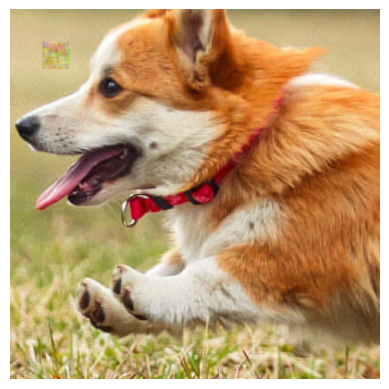

In [83]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


/tmp/ipykernel_4503/319164057.py:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]


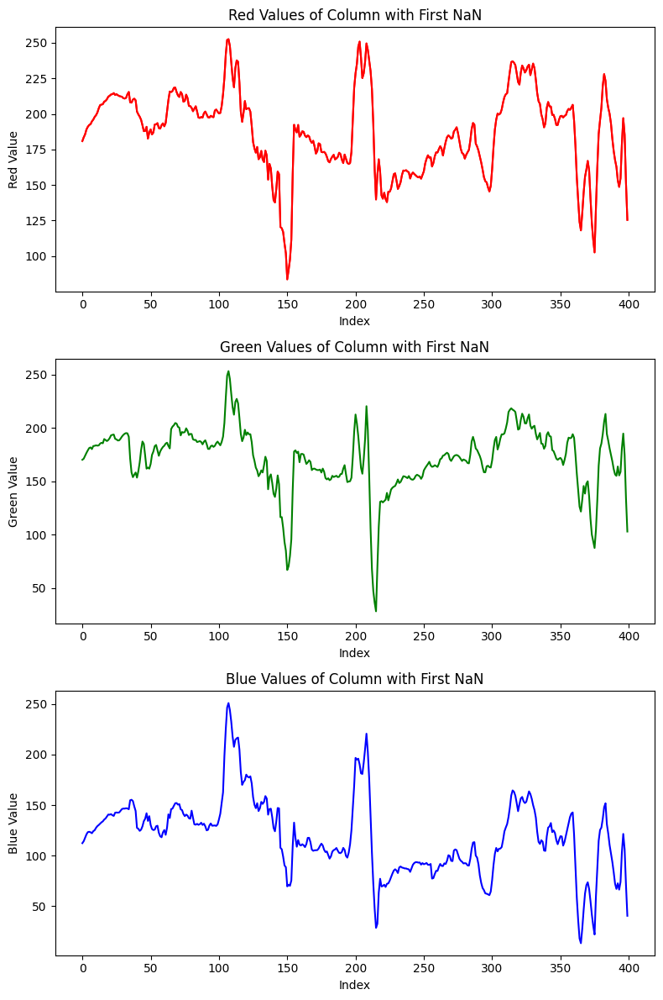

<Figure size 640x480 with 0 Axes>

In [84]:
import matplotlib.pyplot as plt

# Find the column index where the first NaN value occurs
column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]

# Get the red values of the column
red_values = (red_img[:, column_index]).cpu().detach().numpy()
# Get the green values of the column
green_values = (green_img[:, column_index]).cpu().detach().numpy()
# Get the blue values of the column
blue_values = (blue_img[:, column_index]).cpu().detach().numpy()

# Create subplots
fig, axs = plt.subplots(3, 1, figsize=(8, 12))

# Plot the red values
axs[0].plot(red_values, color='red')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')
# Plot the red values with missing values as black
axs[0].plot(red_values, color='red')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')

# Plot the green values with missing values as black
axs[1].plot(green_values, color='green')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values with missing values as black
axs[2].plot(blue_values, color='blue')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()

# Plot the green values
axs[1].plot(green_values, color='green')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values
axs[2].plot(blue_values, color='blue')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()


# Metrics:

In [85]:
import numpy as np

# Convert the predicted image (A) and the original image (img) to numpy arrays
predicted_image = final_img
original_image = img.detach().cpu().numpy()

# Calculate the squared difference between the predicted and original images
squared_diff = np.square(predicted_image - original_image)

# Calculate the mean squared difference
mean_squared_diff = np.mean(squared_diff)

# Calculate the RMSE by taking the square root of the mean squared difference
rmse = np.sqrt(mean_squared_diff)

# Print the RMSE
print("RMSE:", rmse)


RMSE: 3.8976827


In [86]:
import numpy as np

def calculate_psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

psnr = calculate_psnr(final_img, np.array(img))
print("Peak Signal-to-Noise Ratio (PSNR):", psnr)


Peak Signal-to-Noise Ratio (PSNR): 36.597936153411865


# For 2 colours

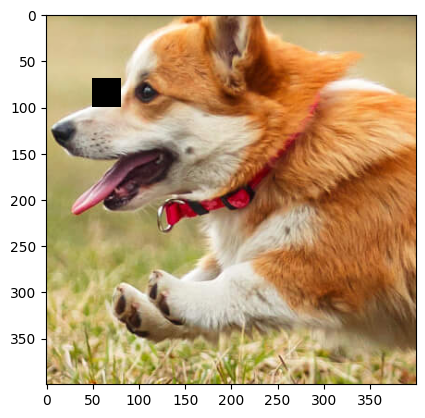

In [87]:
img_23c = img.clone().detach()
img_23c = img_23c.to(torch.float32)
img_23c[70:100, 50:80, :] = torch.nan
plt.imshow(img_23c/255)

In [88]:
img_array = img_23c

In [89]:
## for 2 colours
A = torch.tensor(img_array, dtype=torch.float32, device=device)
k = 100
lambda_reg = 0.14  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)

/tmp/ipykernel_4503/2022244493.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(img_array, dtype=torch.float32, device=device)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


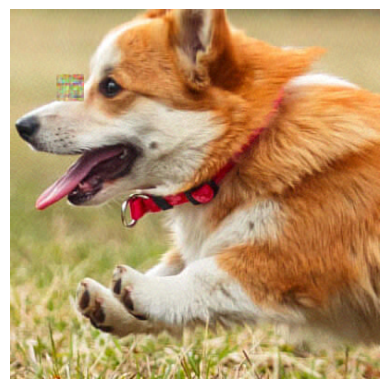

In [90]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


# Metrics:

In [91]:
import numpy as np

# Convert the predicted image (A) and the original image (img) to numpy arrays
predicted_image = final_img
original_image = img.detach().cpu().numpy()

# Calculate the squared difference between the predicted and original images
squared_diff = np.square(predicted_image - original_image)

# Calculate the mean squared difference
mean_squared_diff = np.mean(squared_diff)

# Calculate the RMSE by taking the square root of the mean squared difference
rmse = np.sqrt(mean_squared_diff)

# Print the RMSE
print("RMSE:", rmse)


RMSE: 4.9318085


In [92]:
import numpy as np

def calculate_psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

psnr = calculate_psnr(final_img, np.array(img))
print("Peak Signal-to-Noise Ratio (PSNR):", psnr)


Peak Signal-to-Noise Ratio (PSNR): 34.59115028381348


# For 5 colours

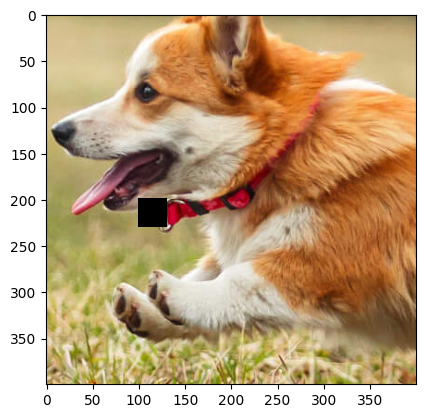

In [93]:
img_5c = img.clone().detach()
img_5c = img_5c.to(torch.float32)
img_5c[200:230, 100:130, :] = torch.nan
plt.imshow(img_5c/255)

In [94]:
img_array = img_5c

In [95]:
# for 5 colour
A = torch.tensor(img_array, dtype=torch.float32, device=device)
k = 100
lambda_reg = 0.09  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)


/tmp/ipykernel_4503/3159195331.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(img_array, dtype=torch.float32, device=device)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


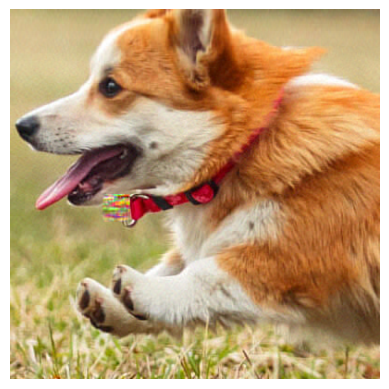

In [96]:
# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


# Metrics:

In [97]:
import numpy as np

# Convert the predicted image (A) and the original image (img) to numpy arrays
predicted_image = final_img
original_image = img.detach().cpu().numpy()

# Calculate the squared difference between the predicted and original images
squared_diff = np.square(predicted_image - original_image)

# Calculate the mean squared difference
mean_squared_diff = np.mean(squared_diff)

# Calculate the RMSE by taking the square root of the mean squared difference
rmse = np.sqrt(mean_squared_diff)

# Print the RMSE
print("RMSE:", rmse)


RMSE: 4.8801975


In [98]:
import numpy as np

def calculate_psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

psnr = calculate_psnr(final_img, np.array(img))
print("Peak Signal-to-Noise Ratio (PSNR):", psnr)


Peak Signal-to-Noise Ratio (PSNR): 37.03752279281616


# N = 20

# For 1 Colour

torch.Size([1200])


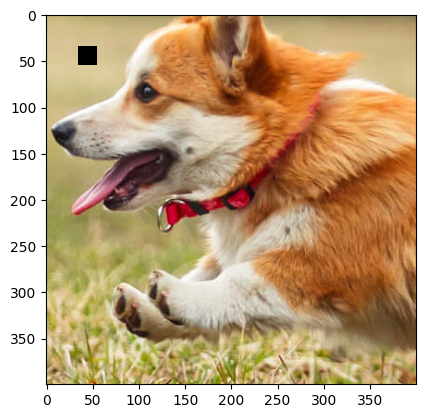

In [99]:
img_1c = img.clone().detach()
img_1c = img_1c.to(torch.float32)
img_1c[35:55, 35:55, :] = torch.nan
plt.imshow(img_1c/255)
print(img_1c[img_1c.isnan()].size())

In [100]:
img_array = img_1c

/tmp/ipykernel_4503/3352673191.py:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]
/tmp/ipykernel_4503/3352673191.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  red_values = torch.tensor(img_array[:, column_index, 0])
/tmp/ipykernel_4503/3352673191.py:9: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  green_values = torch.tensor(img_array[:, column_index, 1])
/tmp/ipykernel_4503/3352673191.py:11: UserWarning: To copy construct from a tensor, it is recommended to use

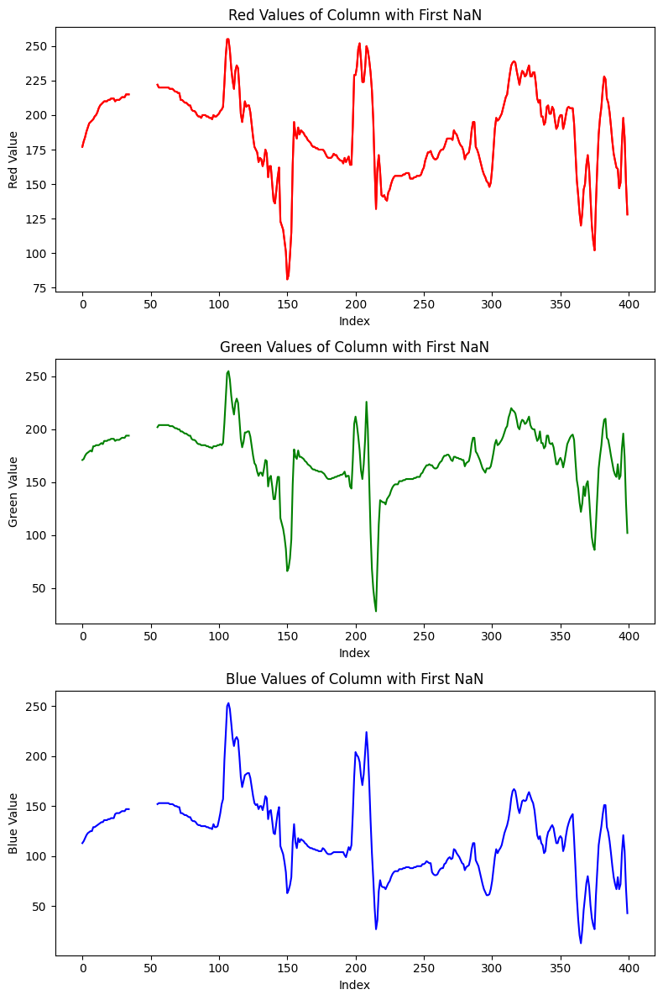

<Figure size 640x480 with 0 Axes>

In [101]:
import matplotlib.pyplot as plt

# Find the column index where the first NaN value occurs
column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]

# Get the red values of the column
red_values = torch.tensor(img_array[:, column_index, 0])
# Get the green values of the column
green_values = torch.tensor(img_array[:, column_index, 1])
# Get the blue values of the column
blue_values = torch.tensor(img_array[:, column_index, 2])

# Create subplots
fig, axs = plt.subplots(3, 1, figsize=(8, 12))

# Plot the red values
axs[0].plot(red_values, color='red')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')
# Plot the red values with missing values as black
axs[0].plot(red_values, color='red')
axs[0].scatter(torch.where(torch.isnan(red_values))[0], red_values[torch.isnan(red_values)], color='black')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')

# Plot the green values with missing values as black
axs[1].plot(green_values, color='green')
axs[1].scatter(torch.where(torch.isnan(green_values))[0], green_values[torch.isnan(green_values)], color='black')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values with missing values as black
axs[2].plot(blue_values, color='blue')
axs[2].scatter(torch.where(torch.isnan(blue_values))[0], blue_values[torch.isnan(blue_values)], color='black')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()

# Plot the green values
axs[1].plot(green_values, color='green')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values
axs[2].plot(blue_values, color='blue')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()


In [102]:
## for 1 colour train the model

A = img_array.clone().detach().to(torch.float32).to(device)
k = 180     # Here, k should be very very small than A.shape[0] and A.shape[1] 
lambda_reg = 0.12  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


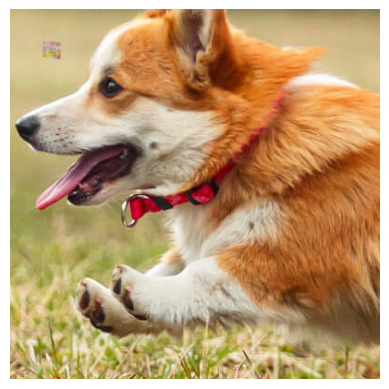

In [103]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


/tmp/ipykernel_4503/319164057.py:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]


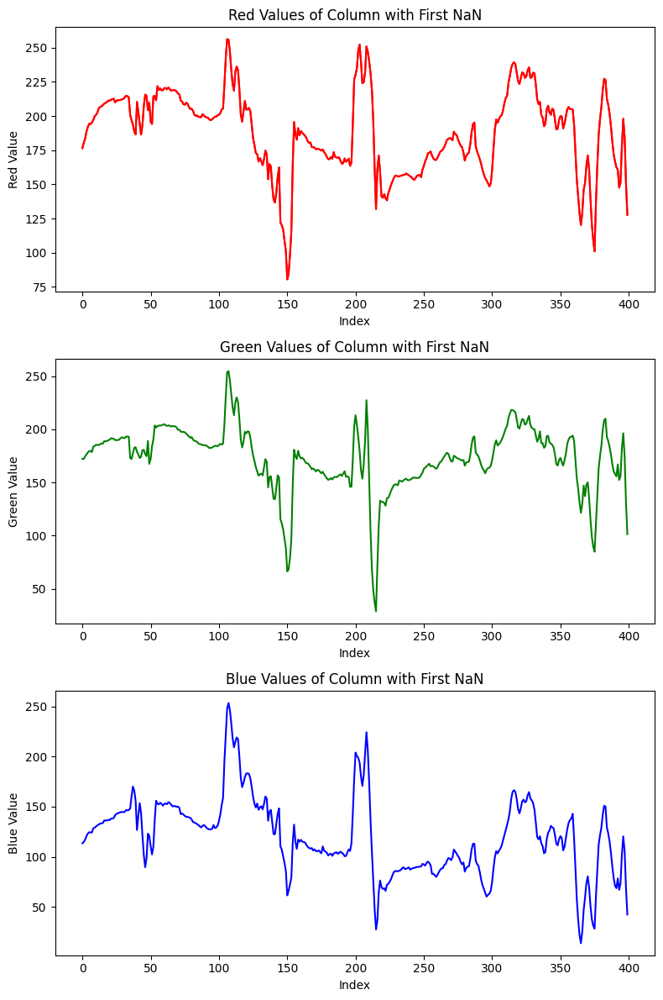

<Figure size 640x480 with 0 Axes>

In [104]:
import matplotlib.pyplot as plt

# Find the column index where the first NaN value occurs
column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]

# Get the red values of the column
red_values = (red_img[:, column_index]).cpu().detach().numpy()
# Get the green values of the column
green_values = (green_img[:, column_index]).cpu().detach().numpy()
# Get the blue values of the column
blue_values = (blue_img[:, column_index]).cpu().detach().numpy()

# Create subplots
fig, axs = plt.subplots(3, 1, figsize=(8, 12))

# Plot the red values
axs[0].plot(red_values, color='red')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')
# Plot the red values with missing values as black
axs[0].plot(red_values, color='red')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')

# Plot the green values with missing values as black
axs[1].plot(green_values, color='green')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values with missing values as black
axs[2].plot(blue_values, color='blue')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()

# Plot the green values
axs[1].plot(green_values, color='green')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values
axs[2].plot(blue_values, color='blue')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()


# Metrics:

In [105]:
import numpy as np

# Convert the predicted image (A) and the original image (img) to numpy arrays
predicted_image = final_img
original_image = img.detach().cpu().numpy()

# Calculate the squared difference between the predicted and original images
squared_diff = np.square(predicted_image - original_image)

# Calculate the mean squared difference
mean_squared_diff = np.mean(squared_diff)

# Calculate the RMSE by taking the square root of the mean squared difference
rmse = np.sqrt(mean_squared_diff)

# Print the RMSE
print("RMSE:", rmse)


RMSE: 1.8813274


In [106]:
import numpy as np

def calculate_psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

psnr = calculate_psnr(final_img, np.array(img))
print("Peak Signal-to-Noise Ratio (PSNR):", psnr)


Peak Signal-to-Noise Ratio (PSNR): 42.73498058319092


# For 2 colours

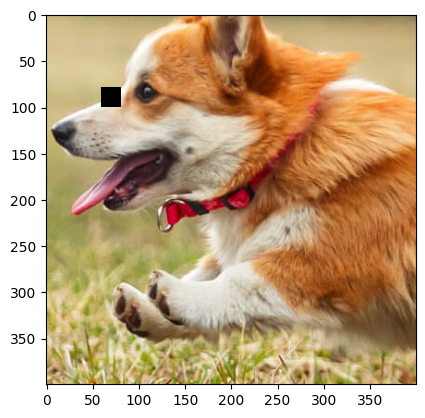

In [107]:
img_23c = img.clone().detach()
img_23c = img_23c.to(torch.float32)
img_23c[80:100, 60:80, :] = torch.nan
plt.imshow(img_23c/255)

In [108]:
img_array = img_23c

In [109]:
## for 2 colours
A = torch.tensor(img_array, dtype=torch.float32, device=device)
k = 200
lambda_reg = 0.14  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)

/tmp/ipykernel_4503/91293281.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(img_array, dtype=torch.float32, device=device)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


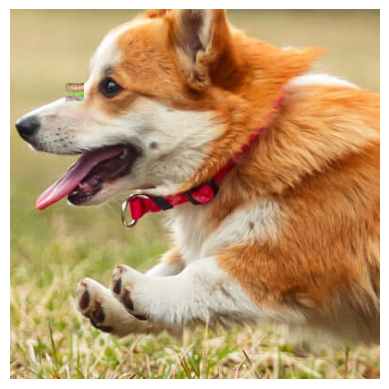

In [110]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


# Metrics:

In [111]:
import numpy as np

# Convert the predicted image (A) and the original image (img) to numpy arrays
predicted_image = final_img
original_image = img.detach().cpu().numpy()

# Calculate the squared difference between the predicted and original images
squared_diff = np.square(predicted_image - original_image)

# Calculate the mean squared difference
mean_squared_diff = np.mean(squared_diff)

# Calculate the RMSE by taking the square root of the mean squared difference
rmse = np.sqrt(mean_squared_diff)

# Print the RMSE
print("RMSE:", rmse)


RMSE: 3.2958014


In [112]:
import numpy as np

def calculate_psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

psnr = calculate_psnr(final_img, np.array(img))
print("Peak Signal-to-Noise Ratio (PSNR):", psnr)


Peak Signal-to-Noise Ratio (PSNR): 37.94416904449463


# For 5 colours

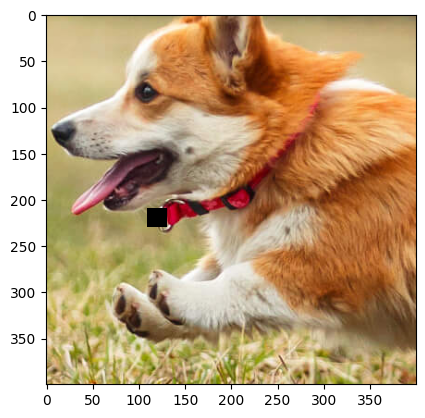

In [113]:
img_5c = img.clone().detach()
img_5c = img_5c.to(torch.float32)
img_5c[210:230, 110:130, :] = torch.nan
plt.imshow(img_5c/255)

In [114]:
img_array = img_5c

In [115]:
# for 5 colour
A = torch.tensor(img_array, dtype=torch.float32, device=device)
k = 100
lambda_reg = 0.09  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)


/tmp/ipykernel_4503/3159195331.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(img_array, dtype=torch.float32, device=device)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


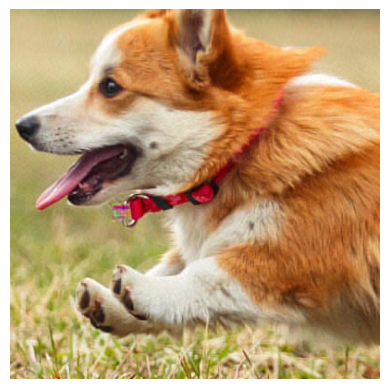

In [116]:
# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


# Metrics:

In [117]:
import numpy as np

# Convert the predicted image (A) and the original image (img) to numpy arrays
predicted_image = final_img
original_image = img.detach().cpu().numpy()

# Calculate the squared difference between the predicted and original images
squared_diff = np.square(predicted_image - original_image)

# Calculate the mean squared difference
mean_squared_diff = np.mean(squared_diff)

# Calculate the RMSE by taking the square root of the mean squared difference
rmse = np.sqrt(mean_squared_diff)

# Print the RMSE
print("RMSE:", rmse)


RMSE: 3.9239852


In [118]:
import numpy as np

def calculate_psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

psnr = calculate_psnr(final_img, np.array(img))
print("Peak Signal-to-Noise Ratio (PSNR):", psnr)


Peak Signal-to-Noise Ratio (PSNR): 36.541430950164795


# For N = 40

# For 1 Colour

torch.Size([4800])


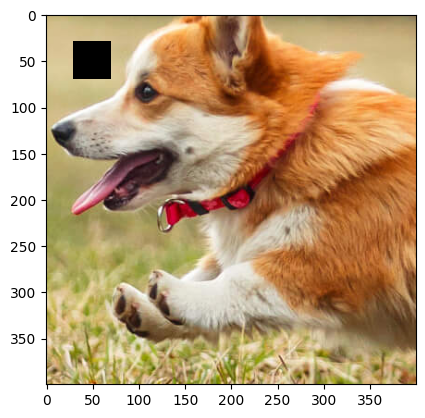

In [119]:
img_1c = img.clone().detach()
img_1c = img_1c.to(torch.float32)
img_1c[30:70, 30:70, :] = torch.nan
plt.imshow(img_1c/255)
print(img_1c[img_1c.isnan()].size())

In [120]:
img_array = img_1c

/tmp/ipykernel_4503/3352673191.py:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]
/tmp/ipykernel_4503/3352673191.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  red_values = torch.tensor(img_array[:, column_index, 0])
/tmp/ipykernel_4503/3352673191.py:9: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  green_values = torch.tensor(img_array[:, column_index, 1])
/tmp/ipykernel_4503/3352673191.py:11: UserWarning: To copy construct from a tensor, it is recommended to use

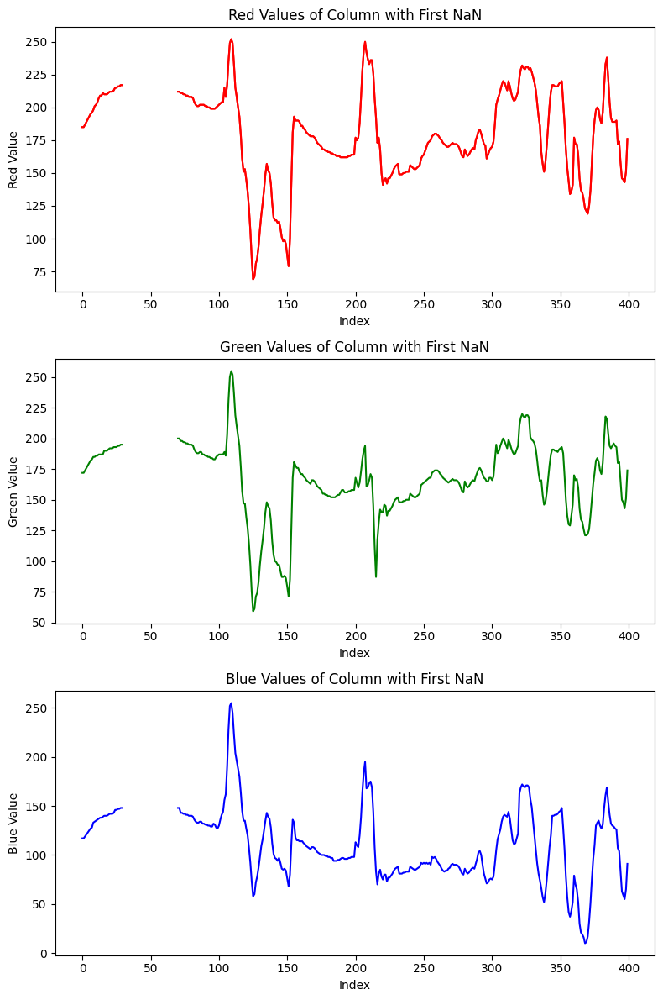

<Figure size 640x480 with 0 Axes>

In [121]:
import matplotlib.pyplot as plt

# Find the column index where the first NaN value occurs
column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]

# Get the red values of the column
red_values = torch.tensor(img_array[:, column_index, 0])
# Get the green values of the column
green_values = torch.tensor(img_array[:, column_index, 1])
# Get the blue values of the column
blue_values = torch.tensor(img_array[:, column_index, 2])

# Create subplots
fig, axs = plt.subplots(3, 1, figsize=(8, 12))

# Plot the red values
axs[0].plot(red_values, color='red')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')
# Plot the red values with missing values as black
axs[0].plot(red_values, color='red')
axs[0].scatter(torch.where(torch.isnan(red_values))[0], red_values[torch.isnan(red_values)], color='black')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')

# Plot the green values with missing values as black
axs[1].plot(green_values, color='green')
axs[1].scatter(torch.where(torch.isnan(green_values))[0], green_values[torch.isnan(green_values)], color='black')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values with missing values as black
axs[2].plot(blue_values, color='blue')
axs[2].scatter(torch.where(torch.isnan(blue_values))[0], blue_values[torch.isnan(blue_values)], color='black')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()

# Plot the green values
axs[1].plot(green_values, color='green')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values
axs[2].plot(blue_values, color='blue')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()


In [122]:
## for 1 colour train the model

A = img_array.clone().detach().to(torch.float32).to(device)
k = 180     # Here, k should be very very small than A.shape[0] and A.shape[1] 
lambda_reg = 0.12  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


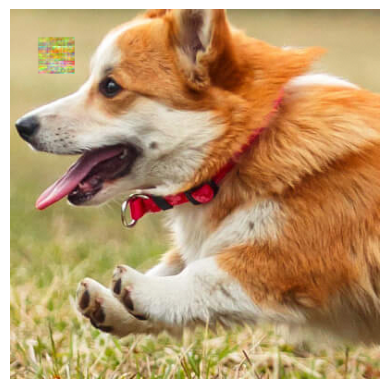

In [123]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


/tmp/ipykernel_4503/319164057.py:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]


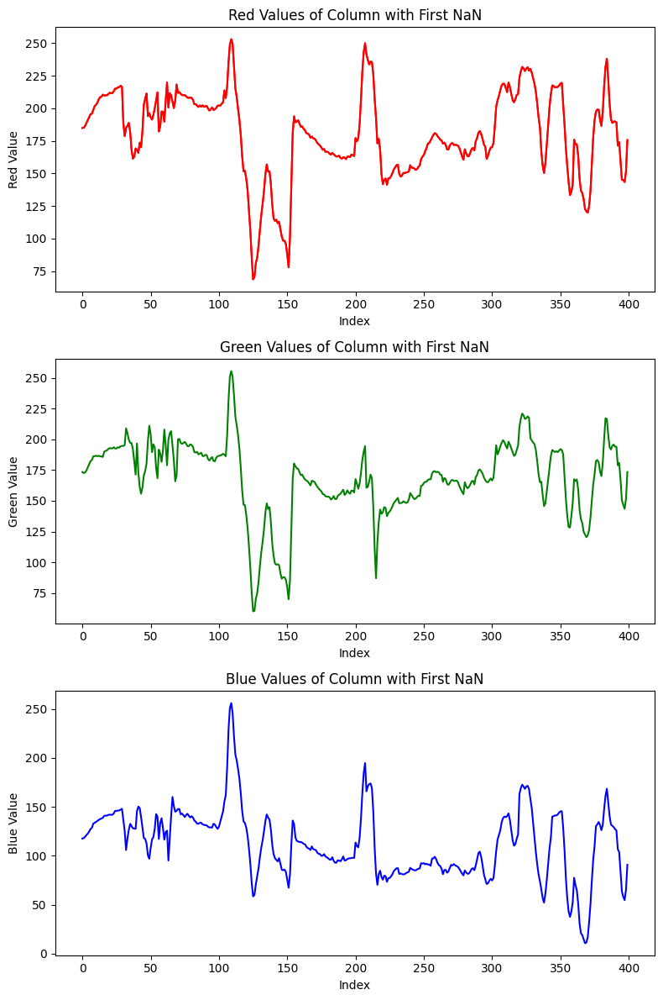

<Figure size 640x480 with 0 Axes>

In [124]:
import matplotlib.pyplot as plt

# Find the column index where the first NaN value occurs
column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]

# Get the red values of the column
red_values = (red_img[:, column_index]).cpu().detach().numpy()
# Get the green values of the column
green_values = (green_img[:, column_index]).cpu().detach().numpy()
# Get the blue values of the column
blue_values = (blue_img[:, column_index]).cpu().detach().numpy()

# Create subplots
fig, axs = plt.subplots(3, 1, figsize=(8, 12))

# Plot the red values
axs[0].plot(red_values, color='red')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')
# Plot the red values with missing values as black
axs[0].plot(red_values, color='red')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')

# Plot the green values with missing values as black
axs[1].plot(green_values, color='green')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values with missing values as black
axs[2].plot(blue_values, color='blue')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()

# Plot the green values
axs[1].plot(green_values, color='green')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values
axs[2].plot(blue_values, color='blue')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()


# Metrics:

In [125]:
import numpy as np

# Convert the predicted image (A) and the original image (img) to numpy arrays
predicted_image = final_img
original_image = img.detach().cpu().numpy()

# Calculate the squared difference between the predicted and original images
squared_diff = np.square(predicted_image - original_image)

# Calculate the mean squared difference
mean_squared_diff = np.mean(squared_diff)

# Calculate the RMSE by taking the square root of the mean squared difference
rmse = np.sqrt(mean_squared_diff)

# Print the RMSE
print("RMSE:", rmse)


RMSE: 4.3019047


In [126]:
import numpy as np

def calculate_psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

psnr = calculate_psnr(final_img, np.array(img))
print("Peak Signal-to-Noise Ratio (PSNR):", psnr)


Peak Signal-to-Noise Ratio (PSNR): 36.11567497253418


# For 2 colours

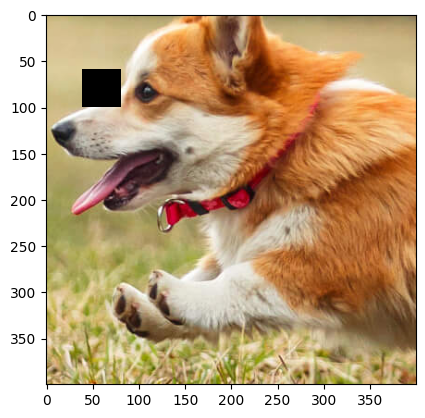

In [127]:
img_23c = img.clone().detach()
img_23c = img_23c.to(torch.float32)
img_23c[60:100, 40:80, :] = torch.nan
plt.imshow(img_23c/255)

In [128]:
img_array = img_23c

In [129]:
## for 2 colours
A = torch.tensor(img_array, dtype=torch.float32, device=device)
k = 200
lambda_reg = 0.14  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)

/tmp/ipykernel_4503/91293281.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(img_array, dtype=torch.float32, device=device)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


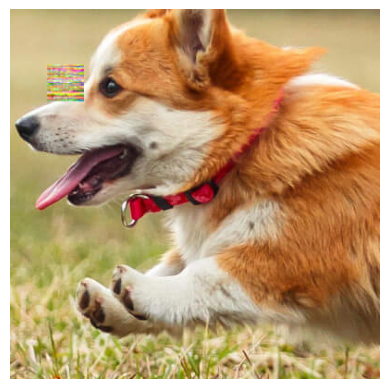

In [130]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


# Metrics:

In [131]:
import numpy as np

# Convert the predicted image (A) and the original image (img) to numpy arrays
predicted_image = final_img
original_image = img.detach().cpu().numpy()

# Calculate the squared difference between the predicted and original images
squared_diff = np.square(predicted_image - original_image)

# Calculate the mean squared difference
mean_squared_diff = np.mean(squared_diff)

# Calculate the RMSE by taking the square root of the mean squared difference
rmse = np.sqrt(mean_squared_diff)

# Print the RMSE
print("RMSE:", rmse)


RMSE: 5.5403013


In [132]:
import numpy as np

def calculate_psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

psnr = calculate_psnr(final_img, np.array(img))
print("Peak Signal-to-Noise Ratio (PSNR):", psnr)


Peak Signal-to-Noise Ratio (PSNR): 34.761033058166504


# For 5 colours

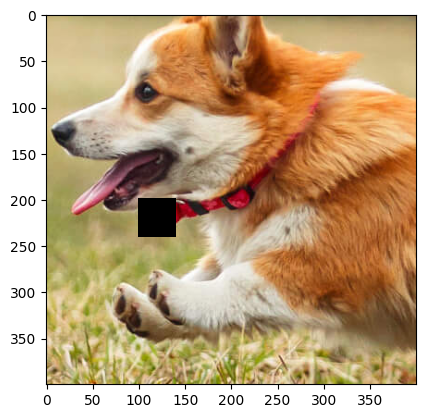

In [133]:
img_5c = img.clone().detach()
img_5c = img_5c.to(torch.float32)
img_5c[200:240, 100:140, :] = torch.nan
plt.imshow(img_5c/255)

In [134]:
img_array = img_5c

In [135]:
# for 5 colour
A = torch.tensor(img_array, dtype=torch.float32, device=device)
k = 100
lambda_reg = 0.09  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)


/tmp/ipykernel_4503/3159195331.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(img_array, dtype=torch.float32, device=device)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


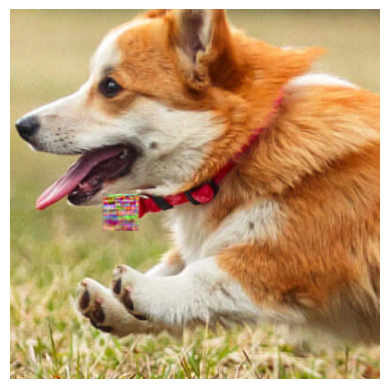

In [136]:
# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


# Metrics:

In [137]:
import numpy as np

# Convert the predicted image (A) and the original image (img) to numpy arrays
predicted_image = final_img
original_image = img.detach().cpu().numpy()

# Calculate the squared difference between the predicted and original images
squared_diff = np.square(predicted_image - original_image)

# Calculate the mean squared difference
mean_squared_diff = np.mean(squared_diff)

# Calculate the RMSE by taking the square root of the mean squared difference
rmse = np.sqrt(mean_squared_diff)

# Print the RMSE
print("RMSE:", rmse)


RMSE: 6.63052


In [138]:
import numpy as np

def calculate_psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

psnr = calculate_psnr(final_img, np.array(img))
print("Peak Signal-to-Noise Ratio (PSNR):", psnr)


Peak Signal-to-Noise Ratio (PSNR): 32.95444965362549


# For N = 60

# For 1 Colour

torch.Size([10800])


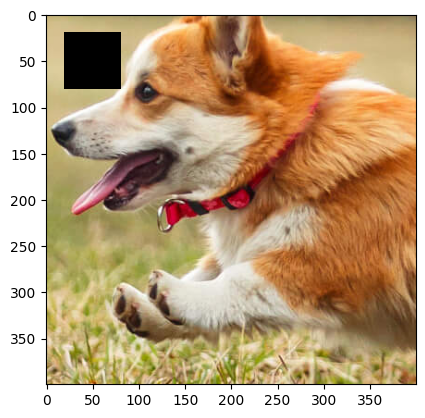

In [139]:
img_1c = img.clone().detach()
img_1c = img_1c.to(torch.float32)
img_1c[20:80, 20:80, :] = torch.nan
plt.imshow(img_1c/255)
print(img_1c[img_1c.isnan()].size())

In [140]:
img_array = img_1c

/tmp/ipykernel_4503/3352673191.py:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]
/tmp/ipykernel_4503/3352673191.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  red_values = torch.tensor(img_array[:, column_index, 0])
/tmp/ipykernel_4503/3352673191.py:9: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  green_values = torch.tensor(img_array[:, column_index, 1])
/tmp/ipykernel_4503/3352673191.py:11: UserWarning: To copy construct from a tensor, it is recommended to use

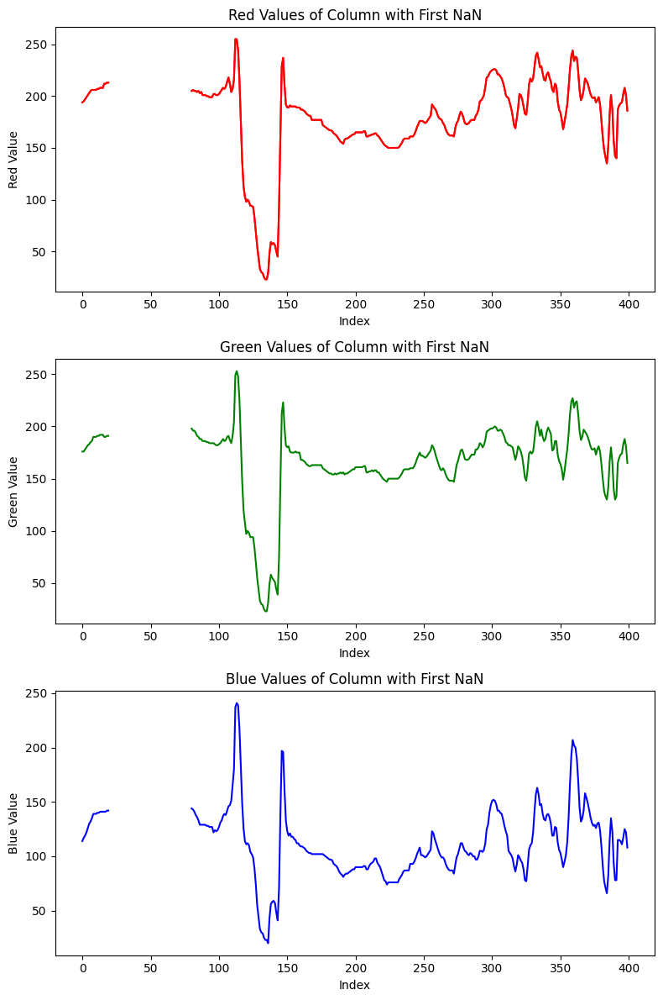

<Figure size 640x480 with 0 Axes>

In [141]:
import matplotlib.pyplot as plt

# Find the column index where the first NaN value occurs
column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]

# Get the red values of the column
red_values = torch.tensor(img_array[:, column_index, 0])
# Get the green values of the column
green_values = torch.tensor(img_array[:, column_index, 1])
# Get the blue values of the column
blue_values = torch.tensor(img_array[:, column_index, 2])

# Create subplots
fig, axs = plt.subplots(3, 1, figsize=(8, 12))

# Plot the red values
axs[0].plot(red_values, color='red')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')
# Plot the red values with missing values as black
axs[0].plot(red_values, color='red')
axs[0].scatter(torch.where(torch.isnan(red_values))[0], red_values[torch.isnan(red_values)], color='black')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')

# Plot the green values with missing values as black
axs[1].plot(green_values, color='green')
axs[1].scatter(torch.where(torch.isnan(green_values))[0], green_values[torch.isnan(green_values)], color='black')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values with missing values as black
axs[2].plot(blue_values, color='blue')
axs[2].scatter(torch.where(torch.isnan(blue_values))[0], blue_values[torch.isnan(blue_values)], color='black')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()

# Plot the green values
axs[1].plot(green_values, color='green')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values
axs[2].plot(blue_values, color='blue')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()


In [142]:
## for 1 colour train the model

A = img_array.clone().detach().to(torch.float32).to(device)
k = 180     # Here, k should be very very small than A.shape[0] and A.shape[1] 
lambda_reg = 0.12  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


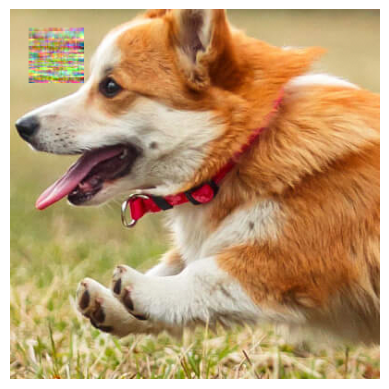

In [143]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


/tmp/ipykernel_4503/319164057.py:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]


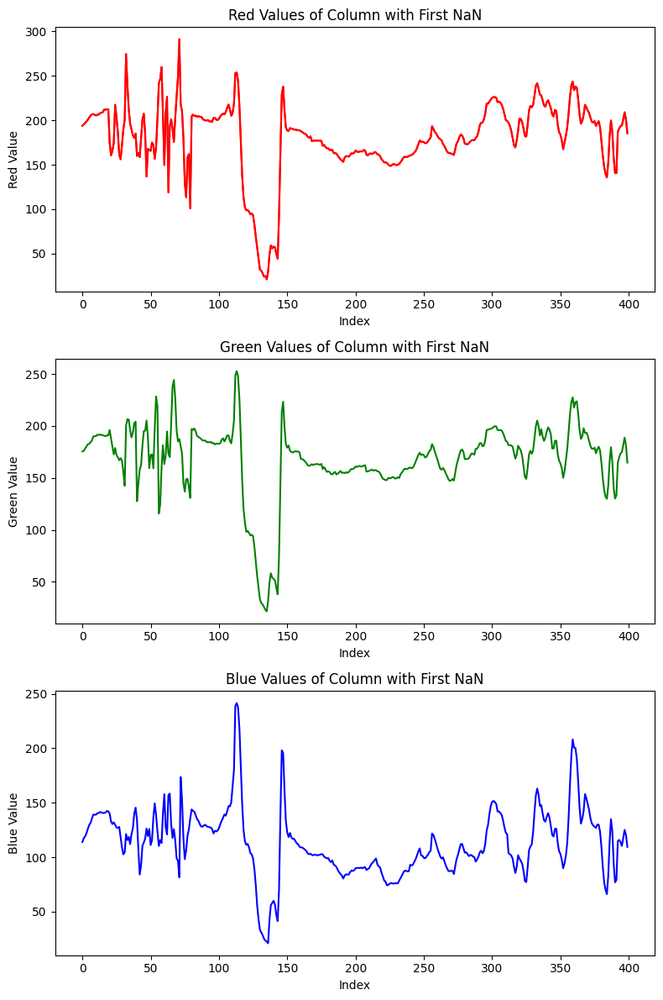

<Figure size 640x480 with 0 Axes>

In [144]:
import matplotlib.pyplot as plt

# Find the column index where the first NaN value occurs
column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]

# Get the red values of the column
red_values = (red_img[:, column_index]).cpu().detach().numpy()
# Get the green values of the column
green_values = (green_img[:, column_index]).cpu().detach().numpy()
# Get the blue values of the column
blue_values = (blue_img[:, column_index]).cpu().detach().numpy()

# Create subplots
fig, axs = plt.subplots(3, 1, figsize=(8, 12))

# Plot the red values
axs[0].plot(red_values, color='red')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')
# Plot the red values with missing values as black
axs[0].plot(red_values, color='red')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')

# Plot the green values with missing values as black
axs[1].plot(green_values, color='green')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values with missing values as black
axs[2].plot(blue_values, color='blue')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()

# Plot the green values
axs[1].plot(green_values, color='green')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values
axs[2].plot(blue_values, color='blue')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()


# Metrics:

In [145]:
import numpy as np

# Convert the predicted image (A) and the original image (img) to numpy arrays
predicted_image = final_img
original_image = img.detach().cpu().numpy()

# Calculate the squared difference between the predicted and original images
squared_diff = np.square(predicted_image - original_image)

# Calculate the mean squared difference
mean_squared_diff = np.mean(squared_diff)

# Calculate the RMSE by taking the square root of the mean squared difference
rmse = np.sqrt(mean_squared_diff)

# Print the RMSE
print("RMSE:", rmse)


RMSE: 7.6785245


In [146]:
import numpy as np

def calculate_psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

psnr = calculate_psnr(final_img, np.array(img))
print("Peak Signal-to-Noise Ratio (PSNR):", psnr)


Peak Signal-to-Noise Ratio (PSNR): 33.00356864929199


# For 2 colours

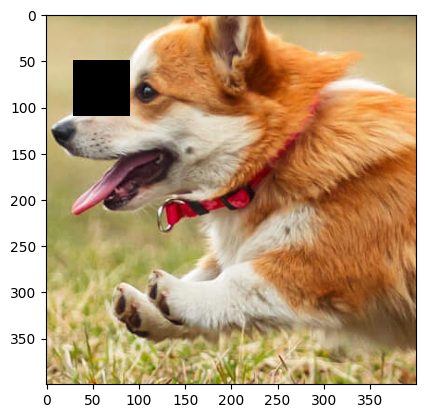

In [147]:
img_23c = img.clone().detach()
img_23c = img_23c.to(torch.float32)
img_23c[50:110, 30:90, :] = torch.nan
plt.imshow(img_23c/255)

In [148]:
img_array = img_23c

In [149]:
## for 2 colours
A = torch.tensor(img_array, dtype=torch.float32, device=device)
k = 200
lambda_reg = 0.14  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)

/tmp/ipykernel_4503/91293281.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(img_array, dtype=torch.float32, device=device)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


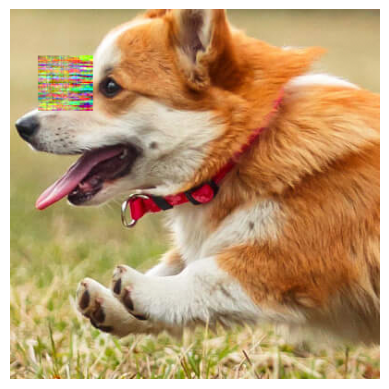

In [150]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


# Metrics:

In [151]:
import numpy as np

# Convert the predicted image (A) and the original image (img) to numpy arrays
predicted_image = final_img
original_image = img.detach().cpu().numpy()

# Calculate the squared difference between the predicted and original images
squared_diff = np.square(predicted_image - original_image)

# Calculate the mean squared difference
mean_squared_diff = np.mean(squared_diff)

# Calculate the RMSE by taking the square root of the mean squared difference
rmse = np.sqrt(mean_squared_diff)

# Print the RMSE
print("RMSE:", rmse)


RMSE: 11.054602


In [152]:
import numpy as np

def calculate_psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

psnr = calculate_psnr(final_img, np.array(img))
print("Peak Signal-to-Noise Ratio (PSNR):", psnr)


Peak Signal-to-Noise Ratio (PSNR): 31.521353721618652


# For 5 colours

/home/ruchitjagodara/.local/lib/python3.10/site-packages/matplotlib/cm.py:494: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


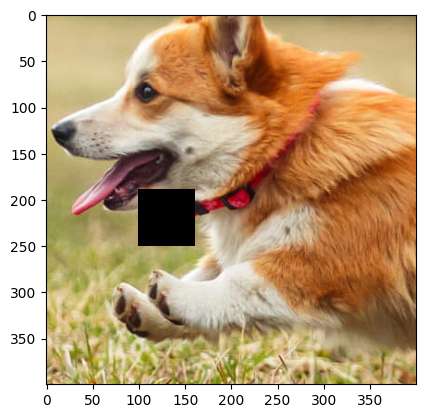

In [4]:
img_5c = img.clone().detach()
img_5c = img_5c.to(torch.float32)
img_5c[190:250, 100:160, :] = torch.nan
plt.imshow(img_5c/255)

In [5]:
img_array = img_5c

In [13]:
# for 5 colour
A = torch.tensor(img_array, dtype=torch.float32, device=device)
k = 100
lambda_reg = 0.09  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)


/tmp/ipykernel_16600/3159195331.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(img_array, dtype=torch.float32, device=device)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


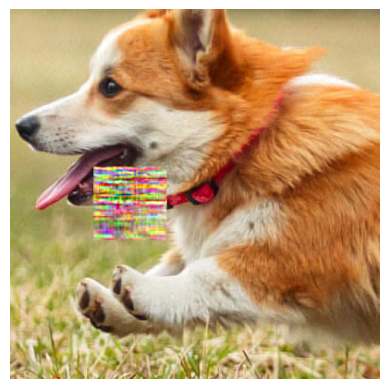

In [14]:
# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


# Metrics:

In [157]:
import numpy as np

# Convert the predicted image (A) and the original image (img) to numpy arrays
predicted_image = final_img
original_image = img.detach().cpu().numpy()

# Calculate the squared difference between the predicted and original images
squared_diff = np.square(predicted_image - original_image)

# Calculate the mean squared difference
mean_squared_diff = np.mean(squared_diff)

# Calculate the RMSE by taking the square root of the mean squared difference
rmse = np.sqrt(mean_squared_diff)

# Print the RMSE
print("RMSE:", rmse)


RMSE: 9.544343


In [158]:
import numpy as np

def calculate_psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

psnr = calculate_psnr(final_img, np.array(img))
print("Peak Signal-to-Noise Ratio (PSNR):", psnr)


Peak Signal-to-Noise Ratio (PSNR): 32.06230163574219


# For N = 80

torch.Size([19200])


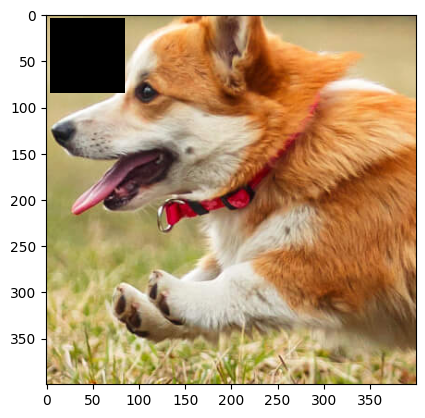

In [159]:
img_1c = img.clone().detach()
img_1c = img_1c.to(torch.float32)
img_1c[5:85, 5:85, :] = torch.nan
plt.imshow(img_1c/255)
print(img_1c[img_1c.isnan()].size())

In [160]:
img_array = img_1c

/tmp/ipykernel_4503/3352673191.py:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]
/tmp/ipykernel_4503/3352673191.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  red_values = torch.tensor(img_array[:, column_index, 0])
/tmp/ipykernel_4503/3352673191.py:9: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  green_values = torch.tensor(img_array[:, column_index, 1])
/tmp/ipykernel_4503/3352673191.py:11: UserWarning: To copy construct from a tensor, it is recommended to use

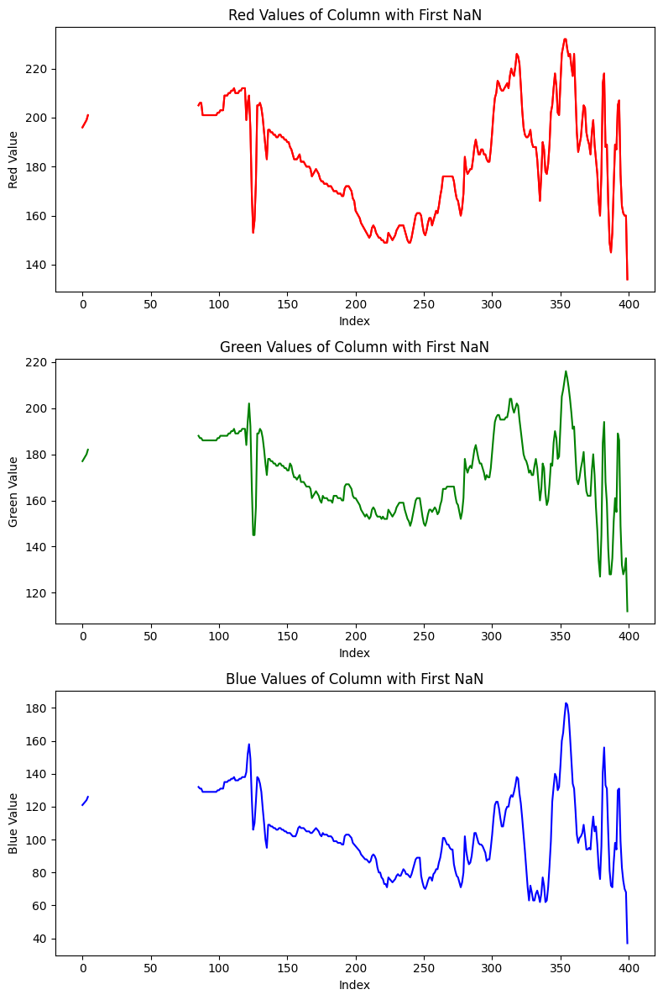

<Figure size 640x480 with 0 Axes>

In [161]:
import matplotlib.pyplot as plt

# Find the column index where the first NaN value occurs
column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]

# Get the red values of the column
red_values = torch.tensor(img_array[:, column_index, 0])
# Get the green values of the column
green_values = torch.tensor(img_array[:, column_index, 1])
# Get the blue values of the column
blue_values = torch.tensor(img_array[:, column_index, 2])

# Create subplots
fig, axs = plt.subplots(3, 1, figsize=(8, 12))

# Plot the red values
axs[0].plot(red_values, color='red')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')
# Plot the red values with missing values as black
axs[0].plot(red_values, color='red')
axs[0].scatter(torch.where(torch.isnan(red_values))[0], red_values[torch.isnan(red_values)], color='black')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')

# Plot the green values with missing values as black
axs[1].plot(green_values, color='green')
axs[1].scatter(torch.where(torch.isnan(green_values))[0], green_values[torch.isnan(green_values)], color='black')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values with missing values as black
axs[2].plot(blue_values, color='blue')
axs[2].scatter(torch.where(torch.isnan(blue_values))[0], blue_values[torch.isnan(blue_values)], color='black')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()

# Plot the green values
axs[1].plot(green_values, color='green')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values
axs[2].plot(blue_values, color='blue')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()


In [162]:
## for 1 colour train the model

A = img_array.clone().detach().to(torch.float32).to(device)
k = 180     # Here, k should be very very small than A.shape[0] and A.shape[1] 
lambda_reg = 0.12  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


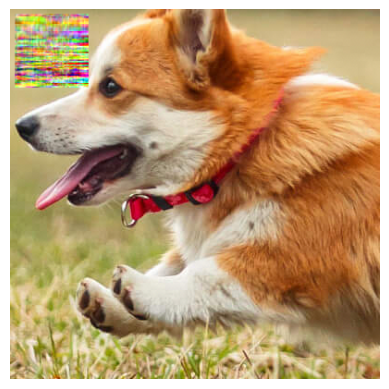

In [163]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


/tmp/ipykernel_4503/319164057.py:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]


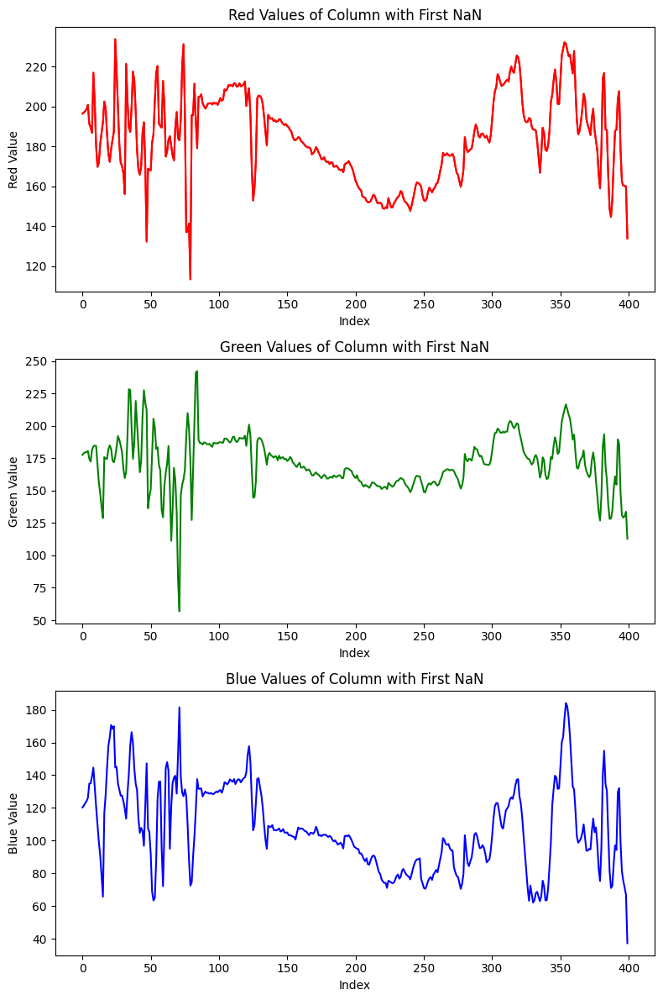

<Figure size 640x480 with 0 Axes>

In [164]:
import matplotlib.pyplot as plt

# Find the column index where the first NaN value occurs
column_index = torch.where(torch.isnan(torch.tensor(img_array)))[1][0]

# Get the red values of the column
red_values = (red_img[:, column_index]).cpu().detach().numpy()
# Get the green values of the column
green_values = (green_img[:, column_index]).cpu().detach().numpy()
# Get the blue values of the column
blue_values = (blue_img[:, column_index]).cpu().detach().numpy()

# Create subplots
fig, axs = plt.subplots(3, 1, figsize=(8, 12))

# Plot the red values
axs[0].plot(red_values, color='red')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')
# Plot the red values with missing values as black
axs[0].plot(red_values, color='red')
axs[0].set_xlabel('Index')
axs[0].set_ylabel('Red Value')
axs[0].set_title('Red Values of Column with First NaN')

# Plot the green values with missing values as black
axs[1].plot(green_values, color='green')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values with missing values as black
axs[2].plot(blue_values, color='blue')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()

# Plot the green values
axs[1].plot(green_values, color='green')
axs[1].set_xlabel('Index')
axs[1].set_ylabel('Green Value')
axs[1].set_title('Green Values of Column with First NaN')

# Plot the blue values
axs[2].plot(blue_values, color='blue')
axs[2].set_xlabel('Index')
axs[2].set_ylabel('Blue Value')
axs[2].set_title('Blue Values of Column with First NaN')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()


# Metrics:

In [165]:
import numpy as np

# Convert the predicted image (A) and the original image (img) to numpy arrays
predicted_image = final_img
original_image = img.detach().cpu().numpy()

# Calculate the squared difference between the predicted and original images
squared_diff = np.square(predicted_image - original_image)

# Calculate the mean squared difference
mean_squared_diff = np.mean(squared_diff)

# Calculate the RMSE by taking the square root of the mean squared difference
rmse = np.sqrt(mean_squared_diff)

# Print the RMSE
print("RMSE:", rmse)


RMSE: 13.241428


In [166]:
import numpy as np

def calculate_psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

psnr = calculate_psnr(final_img, np.array(img))
print("Peak Signal-to-Noise Ratio (PSNR):", psnr)


Peak Signal-to-Noise Ratio (PSNR): 29.646520614624023


# For 2 colours

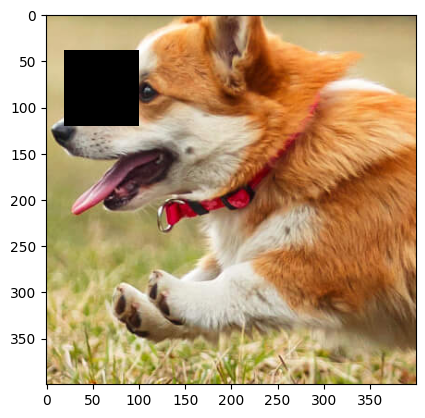

In [167]:
img_23c = img.clone().detach()
img_23c = img_23c.to(torch.float32)
img_23c[40:120, 20:100, :] = torch.nan
plt.imshow(img_23c/255)

In [168]:
img_array = img_23c

In [169]:
## for 2 colours
A = torch.tensor(img_array, dtype=torch.float32, device=device)
k = 200
lambda_reg = 0.14  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)

/tmp/ipykernel_4503/91293281.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(img_array, dtype=torch.float32, device=device)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


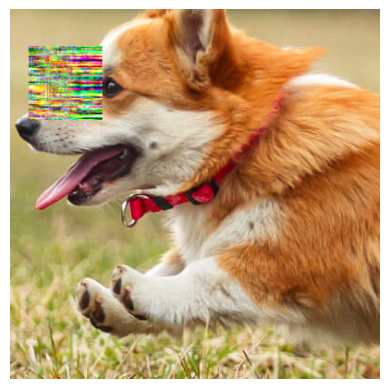

In [170]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


# Metrics:

In [171]:
import numpy as np

# Convert the predicted image (A) and the original image (img) to numpy arrays
predicted_image = final_img
original_image = img.detach().cpu().numpy()

# Calculate the squared difference between the predicted and original images
squared_diff = np.square(predicted_image - original_image)

# Calculate the mean squared difference
mean_squared_diff = np.mean(squared_diff)

# Calculate the RMSE by taking the square root of the mean squared difference
rmse = np.sqrt(mean_squared_diff)

# Print the RMSE
print("RMSE:", rmse)


RMSE: 19.113626


In [172]:
import numpy as np

def calculate_psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

psnr = calculate_psnr(final_img, np.array(img))
print("Peak Signal-to-Noise Ratio (PSNR):", psnr)


Peak Signal-to-Noise Ratio (PSNR): 31.17102861404419


# For 5 colours

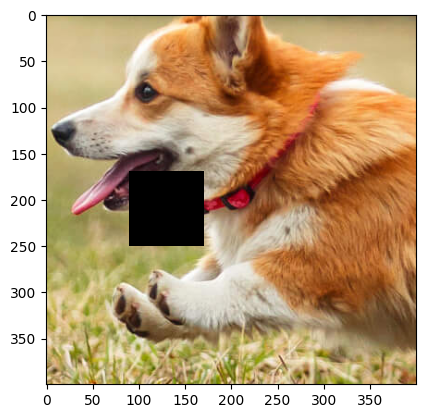

In [9]:
img_5c = img.clone().detach()
img_5c = img_5c.to(torch.float32)
img_5c[170:250, 90:170, :] = torch.nan
plt.imshow(img_5c/255)

In [10]:
img_array = img_5c

In [11]:
# for 5 colour
A = torch.tensor(img_array, dtype=torch.float32, device=device)
k = 100
lambda_reg = 0.09  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)


/tmp/ipykernel_16600/3159195331.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(img_array, dtype=torch.float32, device=device)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


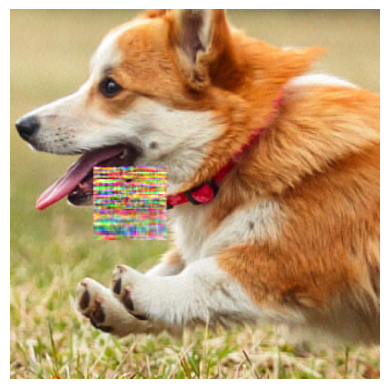

In [12]:
# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


# Metrics:

In [177]:
import numpy as np

# Convert the predicted image (A) and the original image (img) to numpy arrays
predicted_image = final_img
original_image = img.detach().cpu().numpy()

# Calculate the squared difference between the predicted and original images
squared_diff = np.square(predicted_image - original_image)

# Calculate the mean squared difference
mean_squared_diff = np.mean(squared_diff)

# Calculate the RMSE by taking the square root of the mean squared difference
rmse = np.sqrt(mean_squared_diff)

# Print the RMSE
print("RMSE:", rmse)


RMSE: 13.10371


In [178]:
import numpy as np

def calculate_psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    max_pixel = np.max(img1)
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

psnr = calculate_psnr(final_img, np.array(img))
print("Peak Signal-to-Noise Ratio (PSNR):", psnr)


Peak Signal-to-Noise Ratio (PSNR): 28.96162509918213


# Data Compression

In [4]:
N = 50

In [11]:
def factorize(A, k, device, lambda_reg):
    W = torch.randn(A.shape[0], k, dtype=torch.float32, device=device, requires_grad=True)
    H = torch.randn(k, A.shape[1], dtype=torch.float32, device=device, requires_grad=True)
    mask3 = ~torch.isnan(A)
    A_est = torch.matmul(W, H)
    error = torch.norm(A[mask3] - A_est[mask3])
    regularization = lambda_reg * (torch.norm(W) + torch.norm(H))
    loss = error + regularization # here use of regularization is to avoid overfitting and is not necessary here

    optimizer = optim.SGD([W, H], lr=0.02) # Here, we can use Adams optimizer 
    #for normal Gradient Descent we have to just change the SGD with adams
    #and according to the question adams should be used here but we are using SGD to reduce computation time

    # optimizer = optim.Adam([W, H], lr=0.02)

    for i in range(5000):
        optimizer.zero_grad()

        A_est = torch.matmul(W, H)
        error = torch.norm(A[mask3] - A_est[mask3])
        regularization = lambda_reg * (torch.norm(W) + torch.norm(H))
        loss = error + regularization

        loss.backward()
        optimizer.step()

        error = torch.norm(A[mask3] - A_est[mask3])
        # print(error)

    return W, H



# For 1 colour

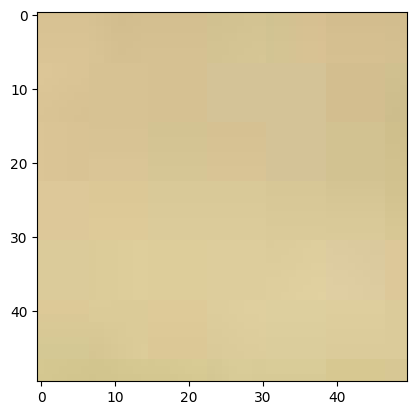

In [12]:
img_1c = img.clone().detach()
img_1c = img_1c.to(torch.float32)
patch = img_1c[50-(N//2):50+(N//2), 50-(N//2):50+(N//2), :]
plt.imshow(patch/255)

# For rank = 5 which is denoted by k here

In [22]:
A = torch.tensor(patch, dtype=torch.float32, device=device)
k = 5
lambda_reg = 0.00  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)


/tmp/ipykernel_5270/4221316518.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(patch, dtype=torch.float32, device=device)


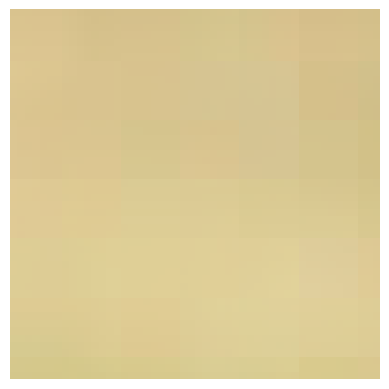

In [24]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


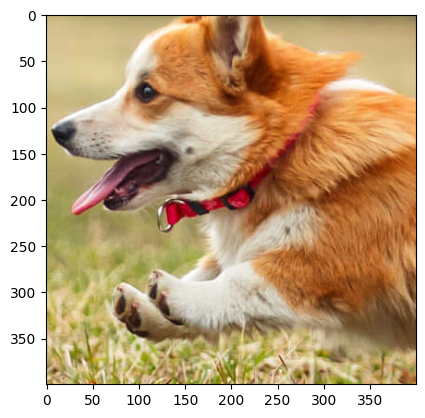

In [27]:
final_constructed_image = img.clone().detach().to(torch.float32).numpy()
final_constructed_image[50-(N//2):50+(N//2), 50-(N//2):50+(N//2), :] = final_img
plt.imshow(final_constructed_image/255)

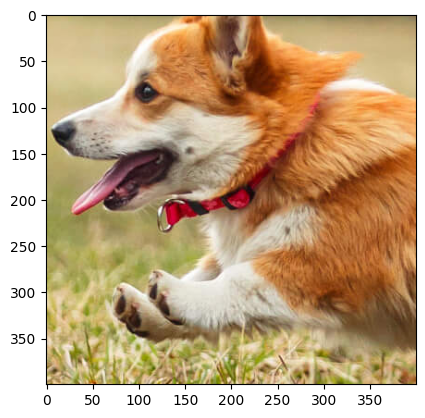

In [28]:
plt.imshow(img/255)

# for rank = 10

In [32]:
A = torch.tensor(patch, dtype=torch.float32, device=device)
k = 10
lambda_reg = 0.00  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)


/tmp/ipykernel_5270/3107616120.py:1: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(patch, dtype=torch.float32, device=device)


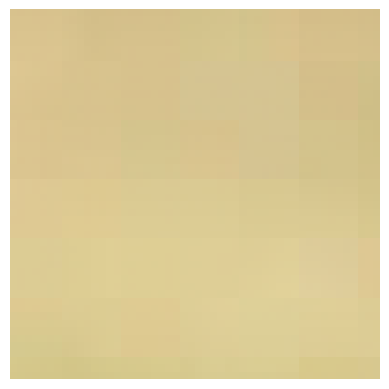

In [33]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


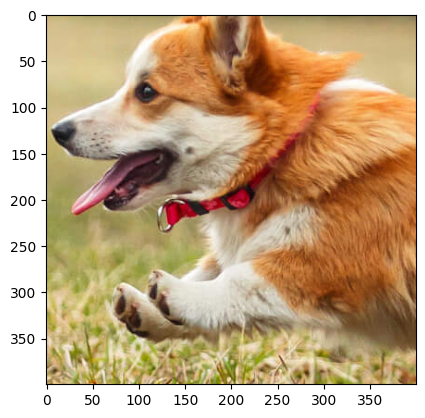

In [34]:
final_constructed_image = img.clone().detach().to(torch.float32).numpy()
final_constructed_image[50-(N//2):50+(N//2), 50-(N//2):50+(N//2), :] = final_img
plt.imshow(final_constructed_image/255)

# For rank = 25

In [47]:
A = torch.tensor(patch, dtype=torch.float32, device=device)
k = 25
lambda_reg = 0.00  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)


/tmp/ipykernel_5270/192198162.py:1: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(patch, dtype=torch.float32, device=device)


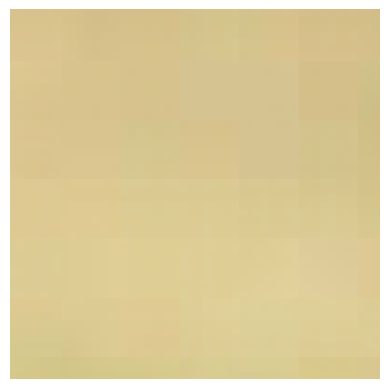

In [48]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


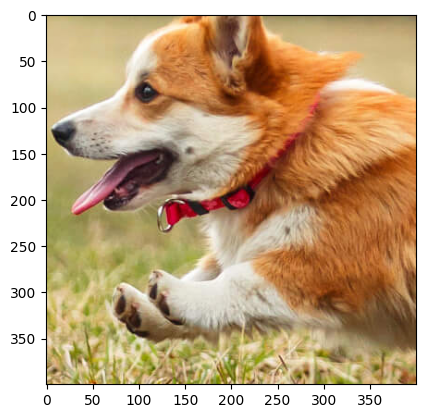

In [49]:
final_constructed_image = img.clone().detach().to(torch.float32).numpy()
final_constructed_image[50-(N//2):50+(N//2), 50-(N//2):50+(N//2), :] = final_img
plt.imshow(final_constructed_image/255)

# For rank = 50

In [50]:
A = torch.tensor(patch, dtype=torch.float32, device=device)
k = 50
lambda_reg = 0.00  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)


/tmp/ipykernel_5270/3685630911.py:1: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(patch, dtype=torch.float32, device=device)


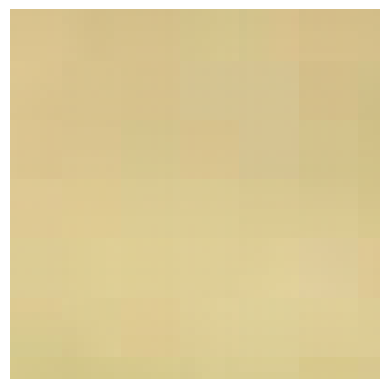

In [51]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


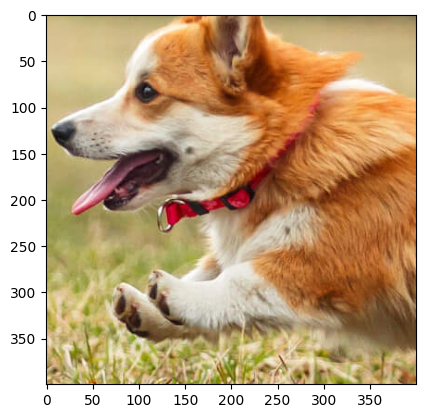

In [52]:
final_constructed_image = img.clone().detach().to(torch.float32).numpy()
final_constructed_image[50-(N//2):50+(N//2), 50-(N//2):50+(N//2), :] = final_img
plt.imshow(final_constructed_image/255)

# For 2-3 colour

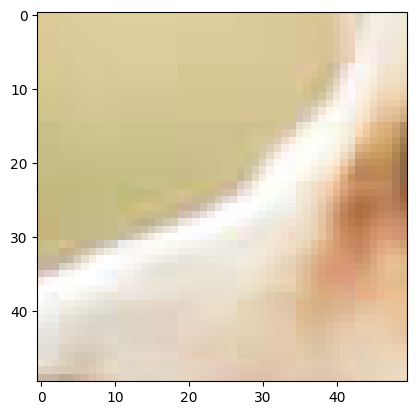

In [54]:
img_23c = img.clone().detach()
img_23c = img_23c.to(torch.float32)
patch = img_23c[65:115, 45:95, :]
plt.imshow(patch/255)

# For rank = 5 which is denoted by k here

In [55]:
A = torch.tensor(patch, dtype=torch.float32, device=device)
k = 5
lambda_reg = 0.00  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)


/tmp/ipykernel_5270/1770419182.py:1: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(patch, dtype=torch.float32, device=device)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


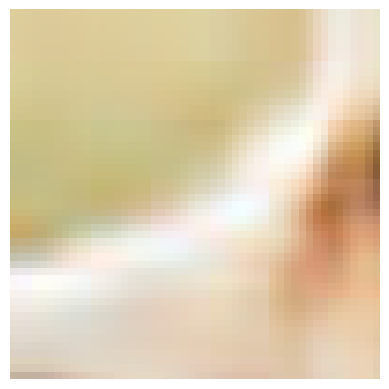

In [56]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


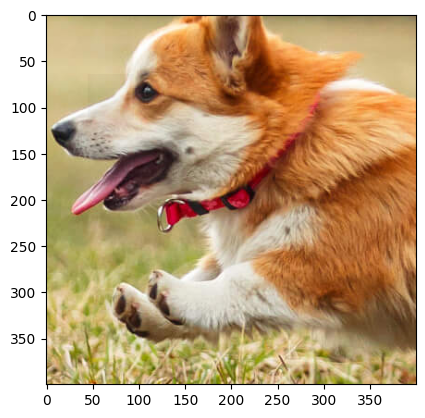

In [70]:
final_constructed_image = img.clone().detach().to(torch.float32).numpy()
final_constructed_image[65:115, 45:95, :] = final_img
plt.imshow(final_constructed_image/255)

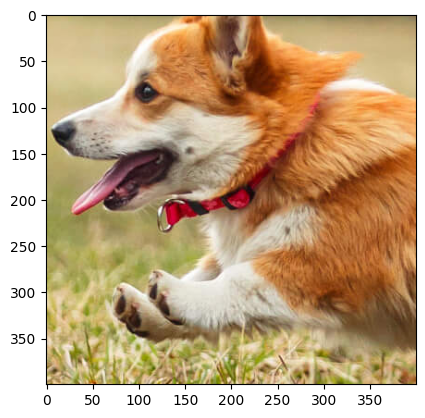

In [58]:
plt.imshow(img/255)

# for rank = 10

In [59]:
A = torch.tensor(patch, dtype=torch.float32, device=device)
k = 10
lambda_reg = 0.00  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)


/tmp/ipykernel_5270/3107616120.py:1: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(patch, dtype=torch.float32, device=device)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


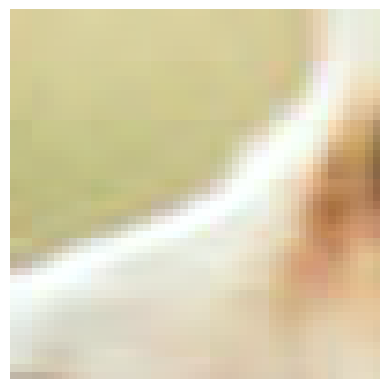

In [60]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


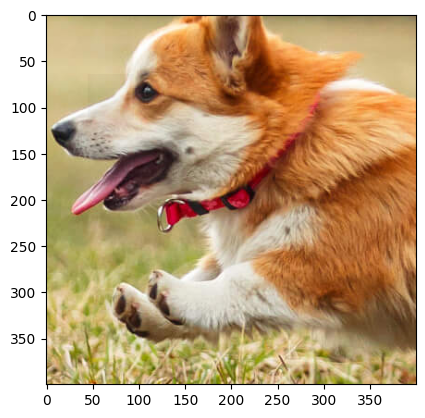

In [68]:
final_constructed_image = img.clone().detach().to(torch.float32).numpy()
final_constructed_image[65:115, 45:95, :] = final_img
plt.imshow(final_constructed_image/255)

# For rank = 25

In [62]:
A = torch.tensor(patch, dtype=torch.float32, device=device)
k = 25
lambda_reg = 0.00  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)


/tmp/ipykernel_5270/192198162.py:1: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(patch, dtype=torch.float32, device=device)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


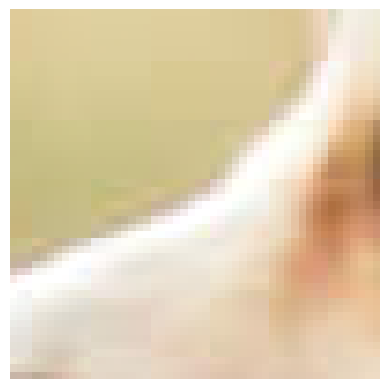

In [63]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


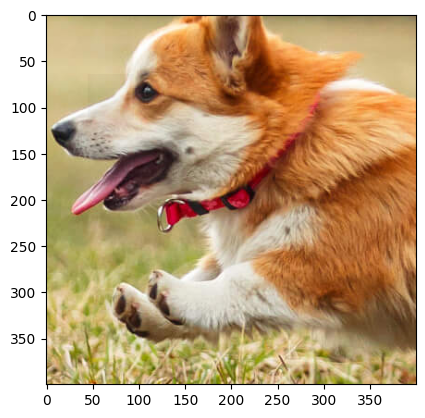

In [69]:
final_constructed_image = img.clone().detach().to(torch.float32).numpy()
final_constructed_image[65:115, 45:95, :] = final_img
plt.imshow(final_constructed_image/255)

# For rank = 50

In [65]:
A = torch.tensor(patch, dtype=torch.float32, device=device)
k = 50
lambda_reg = 0.00  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)


/tmp/ipykernel_5270/3685630911.py:1: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(patch, dtype=torch.float32, device=device)


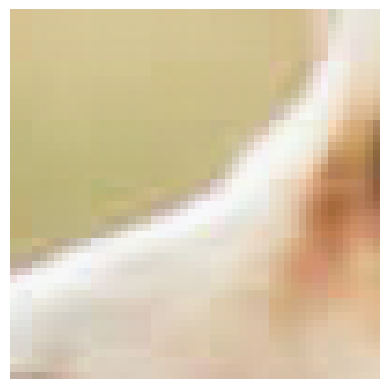

In [71]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


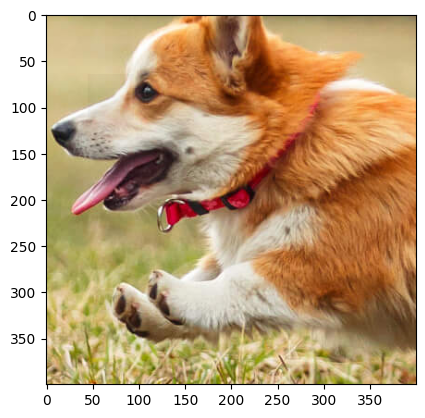

In [72]:
final_constructed_image = img.clone().detach().to(torch.float32).numpy()
final_constructed_image[65:115, 45:95, :] = final_img
plt.imshow(final_constructed_image/255)

# For 5 colour

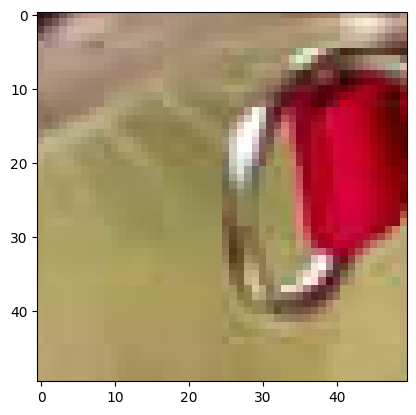

In [73]:
img_23c = img.clone().detach()
img_23c = img_23c.to(torch.float32)
patch = img_23c[195:245, 95:145, :]
plt.imshow(patch/255)

# For rank = 5 which is denoted by k here

In [74]:
A = torch.tensor(patch, dtype=torch.float32, device=device)
k = 5
lambda_reg = 0.00  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)


/tmp/ipykernel_5270/1770419182.py:1: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(patch, dtype=torch.float32, device=device)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


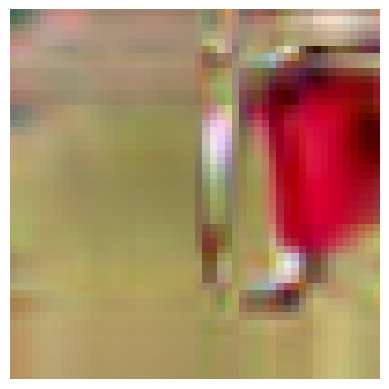

In [75]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


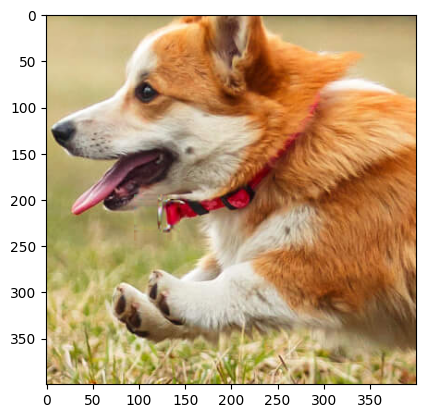

In [76]:
final_constructed_image = img.clone().detach().to(torch.float32).numpy()
final_constructed_image[195:245, 95:145, :] = final_img
plt.imshow(final_constructed_image/255)

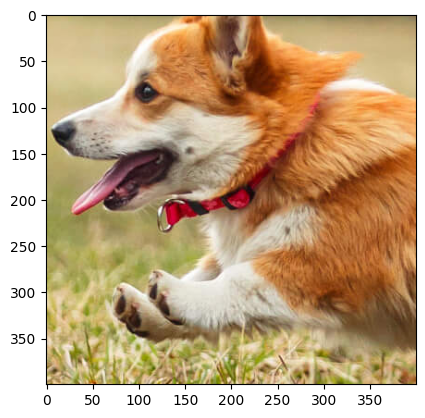

In [ ]:
plt.imshow(img/255)

# for rank = 10

In [77]:
A = torch.tensor(patch, dtype=torch.float32, device=device)
k = 10
lambda_reg = 0.00  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)


/tmp/ipykernel_5270/3107616120.py:1: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(patch, dtype=torch.float32, device=device)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


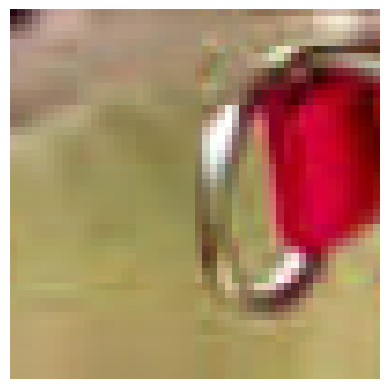

In [78]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


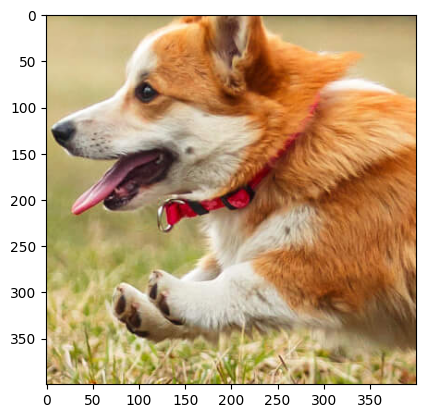

In [79]:
final_constructed_image = img.clone().detach().to(torch.float32).numpy()
final_constructed_image[195:245, 95:145, :] = final_img
plt.imshow(final_constructed_image/255)

# For rank = 25

In [80]:
A = torch.tensor(patch, dtype=torch.float32, device=device)
k = 25
lambda_reg = 0.00  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)


/tmp/ipykernel_5270/192198162.py:1: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(patch, dtype=torch.float32, device=device)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


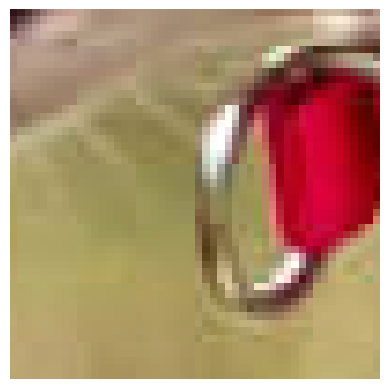

In [81]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


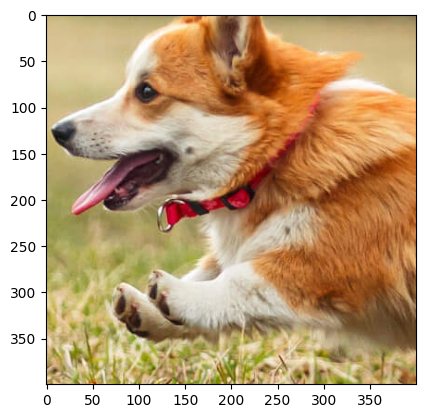

In [82]:
final_constructed_image = img.clone().detach().to(torch.float32).numpy()
final_constructed_image[195:245, 95:145, :] = final_img
plt.imshow(final_constructed_image/255)

# For rank = 50

In [83]:
A = torch.tensor(patch, dtype=torch.float32, device=device)
k = 50
lambda_reg = 0.00  # regularization parameter

# Factorize each color channel separately
W_r, H_r = factorize(A[:, :, 0], k, device, lambda_reg)
W_g, H_g = factorize(A[:, :, 1], k, device, lambda_reg)
W_b, H_b = factorize(A[:, :, 2], k, device, lambda_reg)


/tmp/ipykernel_5270/3685630911.py:1: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  A = torch.tensor(patch, dtype=torch.float32, device=device)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


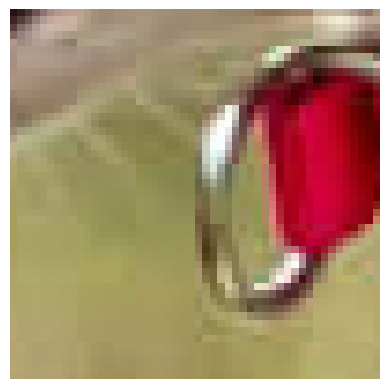

In [84]:
# Plot the reconstructed image

# Multiply W_r with H_r for the red channel
red_img = W_r @ H_r

# Multiply W_g with H_g for the green channel
green_img = W_g @ H_g

# Multiply W_b with H_b for the blue channel
blue_img = W_b @ H_b

# Combine the red, green, and blue channels to form the final image
final_img = np.stack([red_img.cpu().detach().numpy(), green_img.cpu().detach().numpy(), blue_img.cpu().detach().numpy()], axis=-1)

# Display the image
plt.imshow(final_img/255)
plt.axis('off')
plt.show()


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


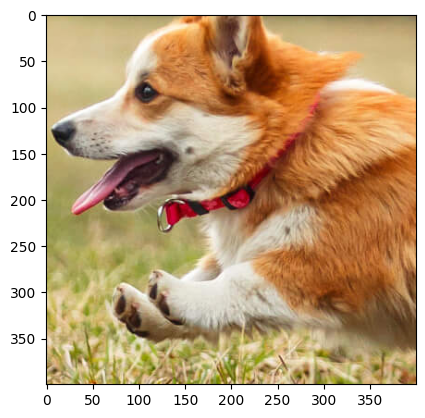

In [85]:
final_constructed_image = img.clone().detach().to(torch.float32).numpy()
final_constructed_image[195:245, 95:145, :] = final_img
plt.imshow(final_constructed_image/255)